Preliminary notebook exploring processing strategies for specific stimulus epochs of V1DD-2P dataset.
Specficially, we will examine the popw will look at the responses to  `drifting_gratings_full`, `spontaneous` and `natural_movies`,

**Initial steps**
- Just focus on volumes 2 and 3 (the "good" volumes)
- Scaling the dF/F traces using a min-max scaler
  - Maybe consider some robust min-max scaling, e.g. between the 1st and 99th percentile
- Bin at the 2s timebins of `drifting_gratings_full`
    - Stringer et al. 2019 used a 1.2-1.3s binning for their analyses, so this is on a similar order.

**Sumary**
- Binned the data for the first epoch of `drifting_gratings_full`
- This data should be in a good preliminary form for Arun to begin working on

*Additional notes*
- Here, just looking at volume 2, one of the good volumes
- Verified robust min-max scaling strategy for dF/F normalization, standard scaling for behavioral variables

**Next steps**
- [Arun] Begin identifying single vs population level correlation to identify soloists vs. choristers in this epoch
- [Libby]: Streamline the processing pipeline so that we can easily apply to other epochs
  - In particular, the binning is a bit clunky and relies on the `drifitng_gratings_full` having defined stimulus times
- [Libby]: Test out different ways to regress out behavior; definitely seems like a big factor
  - Standard scale the behavior variables (by stimulus epoch)
  - Ridge regresssion!!! Extreme collinearity between pupil and running.
  - Vergil: Try out a behavioral gain (multiplicative) modulation. Let A and B be the two behavioral traces. Construct a 3rd variable, $x_C = x_A x x_B$. Now, fit a linear (ridge) regression to the 3 variables. Residuals consist of (pay close attention!!!!:  $$y_\textrm{resid} = [y_A - \hat{y}_A, y_B - \hat{y}_B, y_C/\hat{y}_C]$$
    - Gain modulation of behavioral variables is definitely observed in the visual cortex.
  - Vergil: Using a more complicated model,
  - Minor: Time lagged behavioral variables (although binning should help!)


In [1]:
%load_ext autoreload
%autoreload 2

# general imports 
import os
from pathlib import Path
from pprint import pprint
from tqdm.auto import tqdm

import numpy as np
import scipy
from sklearn.preprocessing import StandardScaler
import pandas as pd 

import matplotlib as mpl
import matplotlib.pyplot as plt
import seaborn as sns
sns.set_context('notebook')

# Add package to path
import sys
sys.path.insert(0, '/root/capsule/code/src')
# Add package to path
import sys
sys.path.insert(0, '/root/capsule/code/src')
from funcky.utils import (
    load_nwb_session,
    get_aligned_session_data,
    get_epoch_data,
    bin_and_avg_data,
)

In [2]:
# Specify data directory location
DATA_DIR = "/data/"  # Code Ocean

# Load metadata csv, which contains session, subject, column, and volume info
metadata = pd.read_csv('/root/capsule/metadata/V1DD_metadata.csv')

## Loading Processed Data 

In [3]:
selected_session = metadata[
    (metadata['golden_mouse']==True)    # mouse with structural info
    & (metadata['column']==1)           # center imaging column
    & (metadata['volume']==3)           # not top or bottom volume
]

assert len(selected_session) == 1, \
    f"Expected exactly 1 session, got {len(selected_session)}"

nwb = load_nwb_session(selected_session.name.item(), DATA_DIR)
session_data = get_aligned_session_data(nwb)

# =============================================================================
# Get stimulus epochs of interest
selected_stimuli = [
    'drifting_gratings_full',
    'spontaneous',
    'natural_movie',
]

stim_epochs_df = nwb.epochs.to_dataframe()
stim_epochs_df = stim_epochs_df[
    stim_epochs_df['stim_name'].isin(selected_stimuli)
]

# =============================================================================
# Filter data
list_of_epoch_data = [
    get_epoch_data(session_data, start_time, stop_time)
    for start_time, stop_time in zip(stim_epochs_df.start_time.values, stim_epochs_df.stop_time.values)
]

# Apply scaling and other processing
# - dff_traces : no additional processing needed
pass

# - behavior_traces : apply standard scaling to each feature independently
# Fit scaler to all data that we are analyzing
list_of_bhv_traces = [dd['behavior_traces'] for dd in list_of_epoch_data]
all_bhv_traces = np.concatenate(list_of_bhv_traces, axis=0) # shape (n_total_time, n_behave)
all_bhv_traces = StandardScaler().fit_transform(all_bhv_traces)




/opt/conda/lib/python3.10/site-packages/hdmf/spec/namespace.py:535: UserWarning: Ignoring cached namespace 'core' version 2.9.0 because version 2.8.0 is already loaded.
  warn("Ignoring cached namespace '%s' version %s because version %s is already loaded."


  0%|          | 0/6 [00:00<?, ?it/s]

/root/capsule/code/src/funcky/utils.py:166: UserWarning: pupil: 516 NaNs detected; fillin in via interpolation.
  warnings.warn(


In [4]:
# To create a widget 
from nwbwidgets import nwb2widget
nwb2widget(nwb)

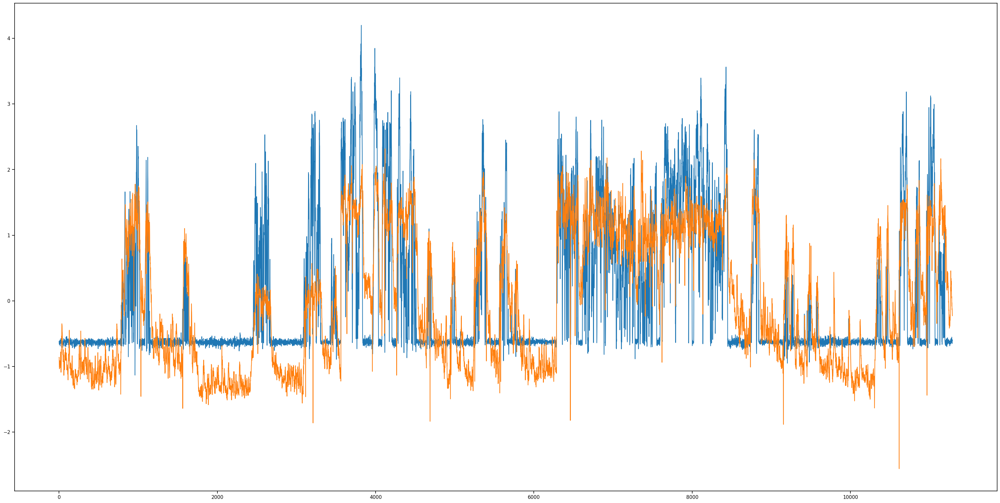

In [5]:
# TO plot the normalized behavior variables 
plt.figure(figsize=(40, 20))
plt.plot(all_bhv_traces)

In [6]:
list_of_epoch_data

[{'timestamps': array([ 54.6618 ,  54.82676,  54.9918 , ..., 341.47273, 341.63969,
         341.80581]),
  'dff_traces': array([[ 0.13634821, -0.26714223,  0.02632359, ..., -0.05684393,
           0.0003789 , -0.14380602],
         [ 0.08650741,  0.07678592,  0.17099719, ..., -0.06270112,
          -0.01472183,  0.07686642],
         [ 0.27962554,  0.        ,  0.09975392, ...,  0.3019819 ,
           0.31176052,  0.05593274],
         ...,
         [ 0.06397747, -0.05361159, -0.05887603, ...,  0.08758204,
          -0.12199155, -0.053741  ],
         [ 0.09767202, -0.0090888 ,  0.02687461, ..., -0.00957911,
          -0.05592565,  0.08467131],
         [ 0.13579193,  0.09354244, -0.02609683, ..., -0.0219679 ,
          -0.06507511, -0.02835498]]),
  'roi_ids': array([  0,   1,   2, ..., 723, 776, 797]),
  'plane_ids': array([0, 0, 0, ..., 5, 5, 5]),
  'volume_ids': array([3, 3, 3, ..., 3, 3, 3]),
  'column_ids': array([1, 1, 1, ..., 1, 1, 1]),
  'behavior_traces': array([[ 2.90150615e

In [7]:
stim_epochs_df = stim_epochs_df.reset_index(drop=True)
stim_epochs_df

,stim_name,start_time,stop_time,duration
0,drifting_gratings_full,54.634430,341.856873,287.222443
1,spontaneous,876.318604,1176.552002,300.233398
2,natural_movie,1343.707764,1794.066162,450.358398
3,drifting_gratings_full,2704.841309,2992.063721,287.222412
4,natural_movie,2997.084473,3537.517822,540.433350


In [12]:
# Archived scripts - AC 
# def filter_session_data(session_data, start_times, stop_times):
#     """Return session data with timestamps and traces filtered by start and stop times.

#     Parameters
#     ----------
#     session_data : dict
#     start_times : float or Sequence[float]
#     stop_times : float or Sequence[float]
#         Start and stop times to filter data by. Must be both scalar or same length sequences.
#     """

#     if isinstance(start_times, float):
#         start_times == [start_times]
#         stop_times == [stop_times]
    
#     if len(start_times) != len(stop_times):
#         raise ValueError(
#             "Expected `start_times` and `stop_times` to be scalars or sequences of the same length, " \
#             + f"but got {len(start_times)=} and {len(stop_times)=}."
#         )
    
#     timestamps = session_data['timestamps']
#     mask = np.zeros_like(timestamps, dtype=bool)
#     for start_time, stop_time in zip(start_times, stop_times):
#         mask |= (timestamps >= start_time) & (timestamps <= stop_time)

#     filtered_session_data = {}
#     for k, v in session_data.items():
#         # If time series field, apply mask
#         if (k=='timestamps') or ('_traces' in k):
#             filtered_session_data[k] = v[...,mask]
        
#         # Else, copy as is
#         else:
#             filtered_session_data[k] = v

#     return filtered_session_data

# selected_session_data =  filter_session_data(session_data, stim_epochs_df.start_time.values, stim_epochs_df.stop_time.values)

# for k, v in selected_session_data.items():
#     print(f"{k}: {v.shape}")

IndexError: boolean index did not match indexed array along dimension 1; dimension is 2708 but corresponding boolean dimension is 21616

**Visualizing population average**

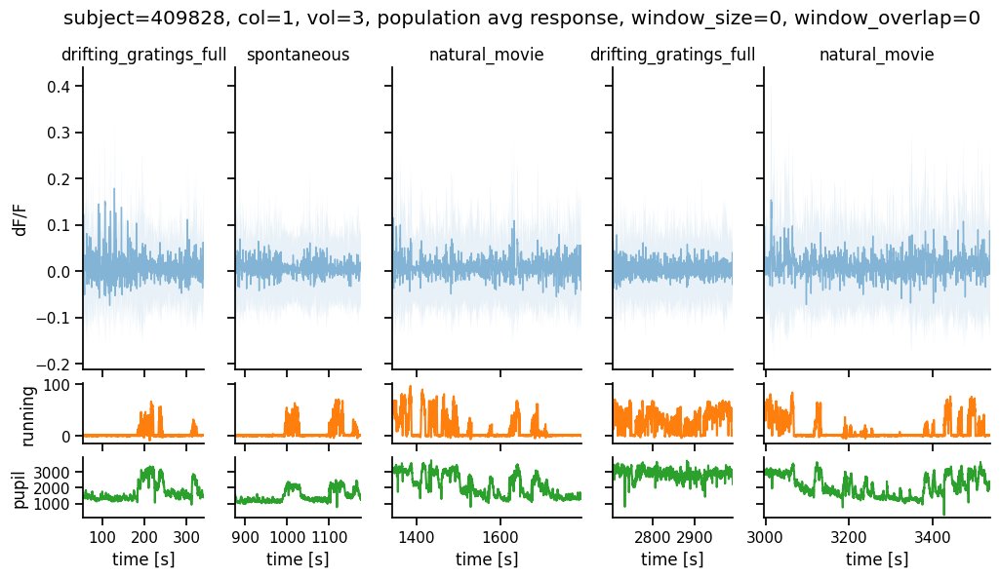

In [8]:
session_data_ = list_of_epoch_data

row_labels = ['dF/F', 'running', 'pupil']

# =========================================================================
width_ratios = np.array([len(dd['timestamps']) for dd in session_data_])

fig, axs = plt.subplots(
    ncols=len(width_ratios), width_ratios=width_ratios, sharey="row",
    nrows=len(row_labels), height_ratios=[1,0.2,0.2], sharex="col",
    figsize=(12,6)
)
fig.subplots_adjust(wspace=0.2, hspace=0.1,)

# Loop through each column, i.e. each stimulus epoch
for i_col, dd in zip(range(axs.shape[-1]), session_data_):

    _ts = dd['timestamps']
    _dff = dd['dff_traces']
    _bhv = dd['behavior_traces']
    _dff_avg = _dff.mean(axis=-1)
    _dff_std = _dff.std(axis=-1)

    # ----------------------------------
    # Row 1: Plot avg population trace
    # ----------------------------------
    i_row = 0
    ax = axs[i_row,i_col]
    ax.plot(_ts, _dff_avg, lw=1, alpha=0.5, c='C0')
    ax.fill_between(
        _ts, _dff_avg-_dff_std, _dff_avg+_dff_std,
        color='C0', ec='none', alpha=0.1, zorder=1
    )  # 1 std

    # ----------------------------------
    # Rows 2+: Plot behavior traces
    # ----------------------------------
    for i_row in range(1, len(axs)):
        ax = axs[i_row,i_col]
        name = row_labels[i_row]

        ax.plot(_ts, _bhv[:,i_row-1], color=f'C{i_row}')    
    
# Make pretty!
for (i_row, i_col), ax in np.ndenumerate(axs):
    ax.margins(x=0.0)

    if ax.get_subplotspec().is_last_row():
        ax.set_xlabel('time [s]')
    
    if ax.get_subplotspec().is_first_col():
        ax.set_ylabel(row_labels[i_row])

    if ax.get_subplotspec().is_first_row():
        ax.set_title(stim_epochs_df.iloc[i_col]['stim_name'])

fig.suptitle(
    f'subject={selected_session.subject_id.item()}, '
    + f'col={selected_session.column.item()}, '
    + f'vol={selected_session.volume.item()}'
    + ', population avg response, window_size=0, window_overlap=0',
)

sns.despine()

### dF/F and behavioral traces, with normalization

**Min-max scaling of dF/F**
We do a robust min-max scaling of the calcium imaging traces, between the 0.5-th to 99.5th percentiles.

In [12]:
for pct in [0, 0.5, 1, 5]:
    print(f"{pct} pct: {np.percentile(selected_session_data['dff_traces'], pct):.3f}")

print()
for pct in [95, 99, 99.5, 99.9, 100]:
    print(f"{pct} pct: {np.percentile(selected_session_data['dff_traces'], pct):.3f}")

NameError: name 'selected_session_data' is not defined

In [14]:
# This function was written to minmax normalize the data 
# def robust_min_max_scaler(arr, min_pct=0, max_pct=100, axis=1):
#     min_val = np.percentile(arr, min_pct, axis=axis, keepdims = True)
#     max_val = np.percentile(arr, max_pct, axis=axis, keepdims = True)
#     print(min_val.shape)
#     return (arr-min_val) / (max_val-min_val)



# from copy import deepcopy
# normd_sel_session_data = deepcopy(selected_session_data)
# normd_sel_session_data['dff_traces'] = robust_min_max_scaler(
#     normd_sel_session_data['dff_traces'], 0.5, 99.9
# )

# # standard scale the behavioral data indepdently
# selected_session_data['behavior_traces'] = np.array([
#     StandardScaler().fit_transform(trace[:,None]).squeeze() for trace in selected_session_data['behavior_traces']
# ])

# for k, v in selected_session_data.items():
#     print(f"{k}: {v.shape}")

NameError: name 'selected_session_data' is not defined

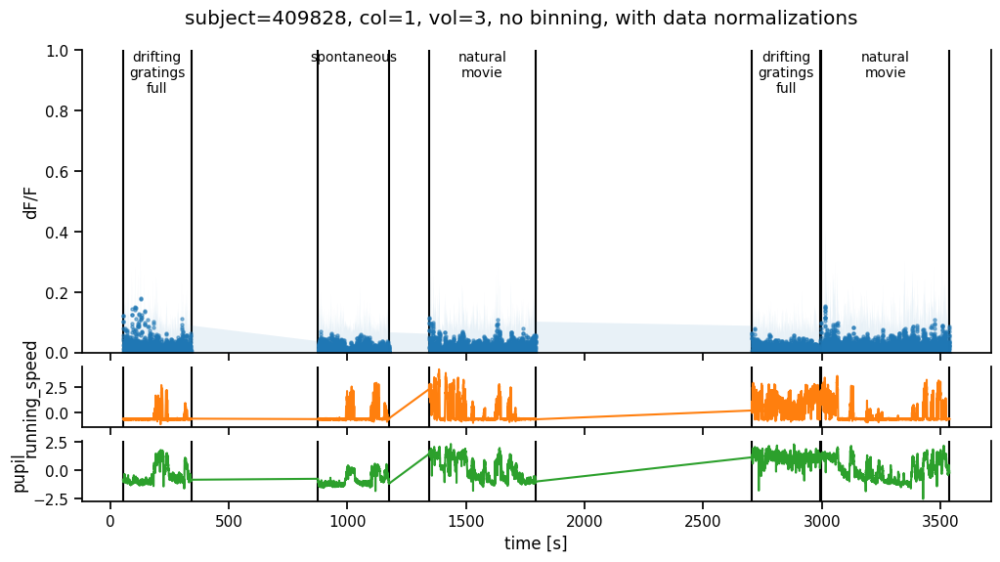

In [7]:
timestamps = selected_session_data['timestamps']
dff_avg = selected_session_data['dff_traces'].mean(axis=0)
dff_std = selected_session_data['dff_traces'].std(axis=0)
behavior_traces = selected_session_data['behavior_traces']
behavior_names = selected_session_data['behavior_names']

# ========================================================================
fig, axs = plt.subplots(
    nrows=3, height_ratios=[1,0.2,0.2], sharex=True,
    figsize=(12,6)
)
fig.subplots_adjust(hspace=0.1)

# -------------------------------------------------------------------------
# Row 1: Plot avg population trace
# -------------------------------------------------------------------------
ax = axs[0]
ax.scatter(timestamps, dff_avg, s=5, alpha=0.5, c='C0', label='df/F')
ax.fill_between(
    timestamps, dff_avg-dff_std, dff_avg+dff_std,
    color='C0', ec='none', alpha=0.1, zorder=1
)

ax.set_ylim(0,1)
ax.set_ylabel("dF/F")

# Add standard scaled behaviors
for i, (ax, name) in enumerate(zip(axs[1:], behavior_names)):
    ax.plot(timestamps, behavior_traces[i], color=f'C{i+1}')
    ax.set_ylabel(name)
    
    # ymin = np.percentile(behavior_traces[i], 2)
    # ymax = np.percentile(behavior_traces[i], 99)
    # ymin, ymax = -1.25, 5
    # ax.set_ylim(ymin,ymax)

# Plot stimulus epochs
for _, row in stim_epochs_df.iterrows():
    stim_name = row['stim_name']
    start_time = row['start_time']
    stop_time = row['stop_time']

    for ax in axs:
        ax.axvline(start_time, color='k', zorder=0)
        ax.axvline(stop_time, color='k', zorder=0)

        # Annotate
        if ax.get_subplotspec().is_first_row():
            xtext = 0.5*(stop_time-start_time) + start_time  # data coordinates
            ax.text(
                xtext, 1, '\n'.join(stim_name.split('_')), transform=ax.get_xaxis_transform(),
                ha='center', va='top', fontsize='small'
            )

# make pretty
ax.set_xlabel("time [s]")
ax.margins(x=0.0)

fig.suptitle(
    f'subject={selected_session.subject_id.item()}, '
    + f'col={selected_session.column.item()}, '
    + f'vol={selected_session.volume.item()}'
    + ', no binning, with data normalizations',
    y=0.95
)

sns.despine(right=False)

## Plot the normalized dff traces and the population average activity as subplot - AC

In [16]:
# Archived code - AC 
# stimulus_table = nwb.intervals['stimulus_table'].to_dataframe()
# stim_epochs_df

,stim_name,start_time,stop_time,duration
0,drifting_gratings_full,54.634430,341.856873,287.222443
1,spontaneous,876.318604,1176.552002,300.233398
2,natural_movie,1343.707764,1794.066162,450.358398
3,drifting_gratings_full,2704.841309,2992.063721,287.222412
4,natural_movie,2997.084473,3537.517822,540.433350


In [13]:
# A code to plot the population activity AC

# def plot_population_activity (stimulus_name,stimulus_order = 0):
    
#     selected_stimulus_table = stimulus_table[
#     (stimulus_table['stim_name'] == stimulus_name)
#     & (stimulus_table['start_time'] <= 341.941071)]  # Stop time of 1st epoch
#     # Get all rows with the desired stimulus name
#     stim_rows = stim_epochs_df[stim_epochs_df['stim_name'] == stimulus_name]

#     # Get the stop_time for the desired order (e.g., 0 for first, 1 for second, etc.)
#     stop_time = stim_rows.iloc[stimulus_order]['stop_time']
#     start_time = stim_rows.iloc[stimulus_order]['start_time']
#     # To get dff traces just for the drfitring gratings: 
#     mask = (selected_session_data['timestamps'] <= stop_time) & (selected_session_data['timestamps'] >= start_time) # To get a mask of just the presentation of the stimulus
    
#     dff_filtered = selected_session_data['dff_traces'][:,mask]
#     print(dff_filtered.shape)
#     population_level_activity = np.mean(dff_filtered, axis = 0)
#     print(population_level_activity.shape)
    
#     fig, axs = plt.subplots(nrows=2, height_ratios=[1,0.2],figsize=(12,6), sharex=True)
#     print(selected_session_data['timestamps'][mask].shape)
#     axs[0].imshow(dff_filtered,vmax=0.7, extent=[selected_session_data['timestamps'][mask][0], selected_session_data['timestamps'][mask][-1], 0, dff_filtered.shape[0]], aspect = "auto")
#     axs[1].plot(selected_session_data['timestamps'][mask], population_level_activity)
#     axs[0].set_title(f" Normalized DFF traces for the epoch {stimulus_name}")
#     axs[1].set_title(f" Average population level activity for the epoch { stimulus_name}")
#     return selected_stimulus_table, dff_filtered

# selected_table_gratings, dff_drifting_gratings_0 = plot_population_activity('drifting_gratings_full')

NameError: name 'stimulus_table' is not defined

In [8]:
stim_epochs_df.iloc[['stim_name'],1]

IndexError: .iloc requires numeric indexers, got ['stim_name']

In [9]:
nwb_stimulus_presentation = nwb.intervals['stimulus_table'].to_dataframe()
stim_names = stim_epochs_df['stim_name'].unique()
nwb_stimulus_presentation = nwb_stimulus_presentation[nwb_stimulus_presentation['stim_name'].isin (stim_names)]
nwb_stimulus_presentation['stim_name'].value_counts()
nwb_stimulus_presentation.head()

,stim_name,start_time,stop_time,temporal_frequency,spatial_frequency,direction,frame,image_order,image_index,stimulus_condition_id
id,,,,,,,,,,
0,drifting_gratings_full,54.634430,56.619442,1.0,0.04,30.0,NaN,NaN,NaN,1
1,drifting_gratings_full,57.636951,59.622009,1.0,0.08,300.0,NaN,NaN,NaN,22
2,drifting_gratings_full,60.639420,62.624439,1.0,0.04,300.0,NaN,NaN,NaN,10
3,drifting_gratings_full,63.641949,65.626930,1.0,0.08,300.0,NaN,NaN,NaN,22
4,drifting_gratings_full,66.644447,68.629433,1.0,0.04,330.0,NaN,NaN,NaN,11


In [37]:
stim_epochs_df['start_time'][1]

876.318603515625

(2708, 1742)
(1742,)


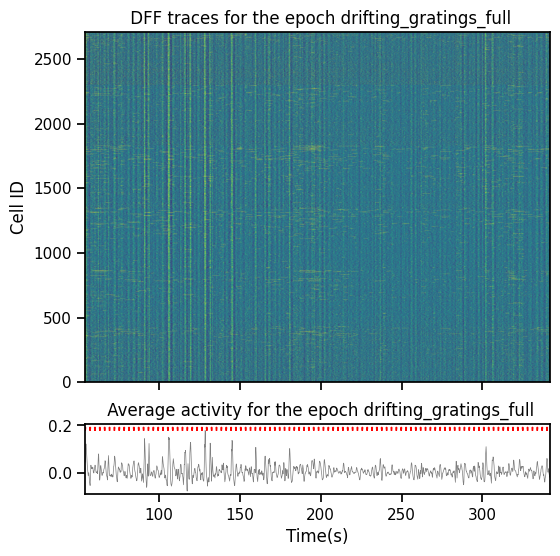

In [10]:
# A code to plot the population activity modified based on new data structure AC 

def plot_population_activity (stimulus_order, add_pointer = 0 ):
    
   
    dff_filtered = list_of_epoch_data[stimulus_order]['dff_traces'].T
    vmin = np.percentile(dff_filtered, 1)
    vmax = np.percentile(dff_filtered, 99)
    print(dff_filtered.shape)
    population_level_activity = np.mean(dff_filtered, axis = 0)
    print(population_level_activity.shape)
     
    epoch_start = stim_epochs_df['start_time'][stimulus_order]
    epoch_stop = stim_epochs_df['stop_time'][stimulus_order]
    
    fig, axs = plt.subplots(nrows=2, height_ratios=[1,0.2],figsize=(6,6), sharex=True)

    im = axs[0].imshow(dff_filtered,vmin = vmin , vmax = vmax, extent=[list_of_epoch_data[stimulus_order]['timestamps'][0], list_of_epoch_data[stimulus_order]['timestamps'][-1], 0, dff_filtered.shape[0]], aspect = "auto")
    axs[1].plot(list_of_epoch_data[stimulus_order]['timestamps'], population_level_activity, linewidth=0.5, color = "tab:gray")
    axs[0].set_xlim(epoch_start,epoch_stop)
    axs[0].set_title(f" DFF traces for the epoch {stim_epochs_df.loc[stimulus_order,'stim_name']}")
    axs[0].set_ylabel("Cell ID")
    axs[1].set_title(f" Average activity for the epoch {stim_epochs_df.loc[stimulus_order,'stim_name']}")
    axs[1].set_xlim(epoch_start,epoch_stop)
    axs[1].set_xlabel("Time(s)")
    # plt.colorbar(im, ax=axs[0] ,orientation='vertical', shrink=0.6, pad=0.5)
    # Find all stimulus onsets within the epoch
    if add_pointer == 1: 
        y_top = axs[1].get_ylim()[1]
        arrow_length = 0.05 * (axs[1].get_ylim()[1] - axs[1].get_ylim()[0]) 
        mask = (nwb_stimulus_presentation['start_time'] >= epoch_start) & \
               (nwb_stimulus_presentation['start_time'] <= epoch_stop)
        for stim_time in nwb_stimulus_presentation['start_time'][mask]:
            axs[1].arrow(
                stim_time, y_top, 0, -arrow_length,  # arrow points downward from top
                head_width=0.5, head_length=arrow_length,
                fc='red', ec='red', length_includes_head=True
            )
    

    plt.savefig(f"/results/simulus_order_{stim_epochs_df.loc[stimulus_order,'stim_name']}")
    return dff_filtered


dff_drifting_gratings_0 = plot_population_activity(0, add_pointer = 1)

(2708, 1735)
(1735,)


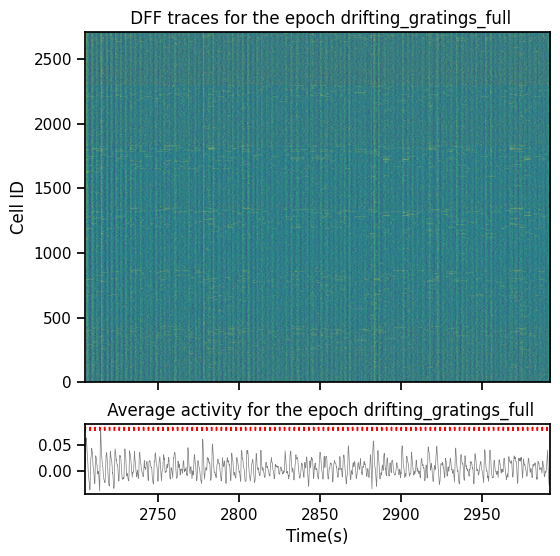

In [11]:


dff_drifting_gratings_1 = plot_population_activity(3, add_pointer = 1)



(2708, 2725)
(2725,)


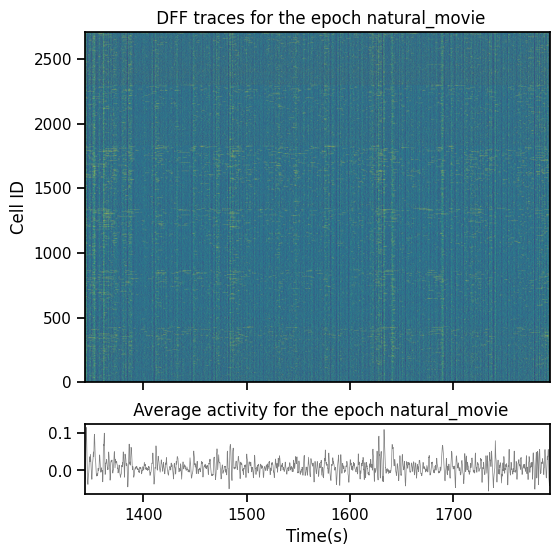

In [12]:
dff_natural_movies_0 = plot_population_activity(2, add_pointer = 0)

(2708, 3267)
(3267,)


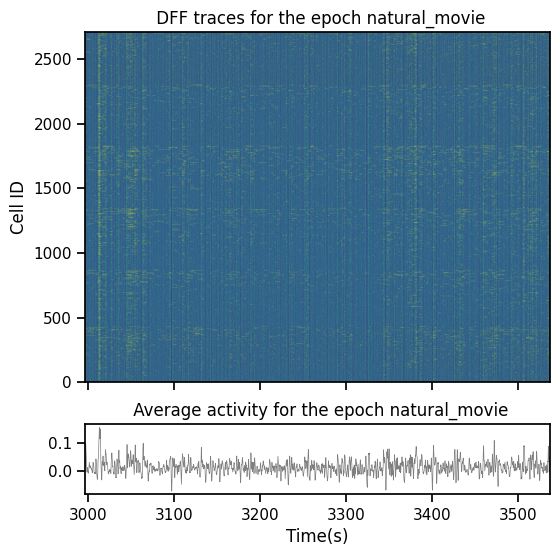

In [13]:
dff_natural_movies_1 = plot_population_activity(4)

(2708, 1820)
(1820,)


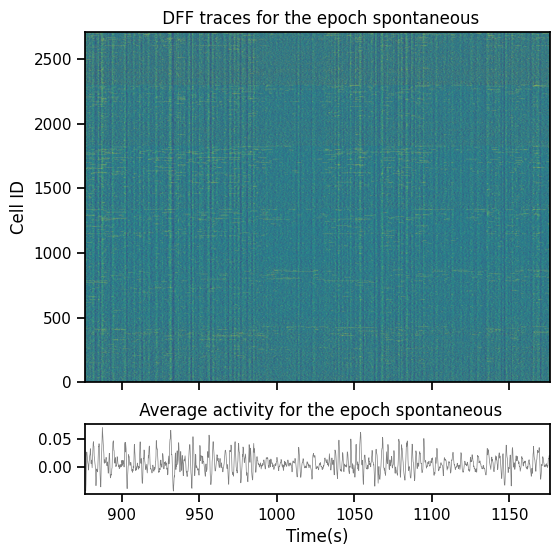

In [14]:
dff_spontaneous = plot_population_activity(1)

In [15]:
# Creating a dictionary of dff traces for each conditions 
dff_dict = {'dff_gratings' : dff_drifting_gratings_0, 'dff_gratings_2' : dff_drifting_gratings_1, 'dff_natural_movies_0' : dff_natural_movies_0, 'dff_natural_movies_1' : dff_natural_movies_1, 'dff_spontaneous' : dff_spontaneous}

In [16]:
# TO check the stimulus epoch 
stim_epochs_df

,stim_name,start_time,stop_time,duration
0,drifting_gratings_full,54.634430,341.856873,287.222443
1,spontaneous,876.318604,1176.552002,300.233398
2,natural_movie,1343.707764,1794.066162,450.358398
3,drifting_gratings_full,2704.841309,2992.063721,287.222412
4,natural_movie,2997.084473,3537.517822,540.433350


In [60]:
# Code to calculate the index for each plane 

last_index = []
for i in range(6):
    print(i)
    indices = np.where(selected_session_data['plane_ids'] == i)[0]
    if len(indices) > 0:
        last_index.append(indices[0])
    else:
        last_index = None  # or handle the case where the plane_id is not found
        
last_index

0


NameError: name 'selected_session_data' is not defined

In [21]:
# # Code to calculate population couling metrics across different stimulus - AC
# def population_coupling(stimulus_name,stimulus_order = 0):
#     # Mask the session of interest
#      # Get all rows with the desired stimulus name
#     stim_rows = stim_epochs_df[stim_epochs_df['stim_name'] == stimulus_name]

#     # Get the stop_time for the desired order (e.g., 0 for first, 1 for second, etc.)
#     stop_time = stim_rows.iloc[stimulus_order]['stop_time']
#     start_time = stim_rows.iloc[stimulus_order]['start_time']
#     # To get dff traces just for the drfitring gratings: 
#     mask = (selected_session_data['timestamps'] <= stop_time) & (selected_session_data['timestamps'] >= start_time) # To get a mask of just the presentation of the stimulus
    
#     dff_drifting_one = selected_session_data['dff_traces'][:,mask]
#     cell_coupling = np.zeros((1,dff_drifting_one.shape[0])).T
#     for idx in range(dff_drifting_one.shape[0]): 
#         single_cell =dff_drifting_one[idx,:]
#         population_activity = np.mean(np.delete(dff_drifting_one,idx, axis = 0), axis=0)
#         cell_coupling[idx] = np.corrcoef(population_activity, single_cell)[0, 1]
    
#     return cell_coupling

# cell_coupling_drifting_gratings_full = population_coupling('drifting_gratings_full')
# cell_coupling_drifting_gratings_full_1 = population_coupling('drifting_gratings_full',1)
# cell_coupling_natural_movies = population_coupling('natural_movie')
# cell_coupling_natural_movies_1 = population_coupling('natural_movie',1)
# cell_coupling_spontaneous = population_coupling('spontaneous')

# cell_coupling = { 'p_coupling_drifting_gratings_full' : cell_coupling_drifting_gratings_full,'p_coupling_drifting_gratings_full_1' : cell_coupling_drifting_gratings_full_1, 
#                  'p_coupling_natural_movies': cell_coupling_natural_movies,
#                  'p_coupling_natural_movies_1': cell_coupling_natural_movies_1, 'p_coupling_spontaneous': cell_coupling_spontaneous}


# fig, ax = plt.subplots(nrows=3,ncols =2, figsize= (12,12), sharey = 'row')
# color_maps = ['tab:green', 'tab:brown', 'tab:cyan', 'tab:red', 'tab:blue', 'tab:orange']

# ax=ax.flatten()



# for idx, (key,p_coupling) in enumerate(cell_coupling.items()):
#     ax[idx].scatter(np.linspace(0,len(p_coupling)-1,len(p_coupling)),p_coupling,s=0.5, c=color_maps[idx])
#     ax[idx].set_title(f"{key}")
#     ax[idx].set_xlabel("Cell IDs")
#     ax[idx].set_ylabel("Population coupling")
#     for x in last_index:
#         ax[idx].axvline(x)
# # Hide the unused subplot
# ax[6].axis('off')

NameError: name 'selected_session_data' is not defined

In [17]:
list_of_epoch_data[0]['dff_traces'].shape

(1742, 2708)

In [18]:
# Code to calculate population coupling metrics across different stimulus - AC 
def population_coupling(stimulus_order = 0):
    
    list_of_epoch_data[stimulus_order]['dff_traces']  
    dff_traces = list_of_epoch_data[stimulus_order]['dff_traces'].T
    cell_coupling = np.zeros((1,dff_traces.shape[0])).T
    for idx in range(dff_traces.shape[0]): 
        single_cell =dff_traces[idx,:]
        population_activity = np.mean(np.delete(dff_traces,idx, axis = 0), axis=0)
        cell_coupling[idx] = np.corrcoef(population_activity, single_cell)[0, 1]
    return cell_coupling

cell_coupling_drifting_gratings_full = population_coupling(0)
cell_coupling_drifting_gratings_full_1 = population_coupling(3)
cell_coupling_natural_movies = population_coupling(2)
cell_coupling_natural_movies_1 = population_coupling(4)
cell_coupling_spontaneous = population_coupling(1)

(0.0, 1.0, -0.10264216638021781, 0.4312029671260432)

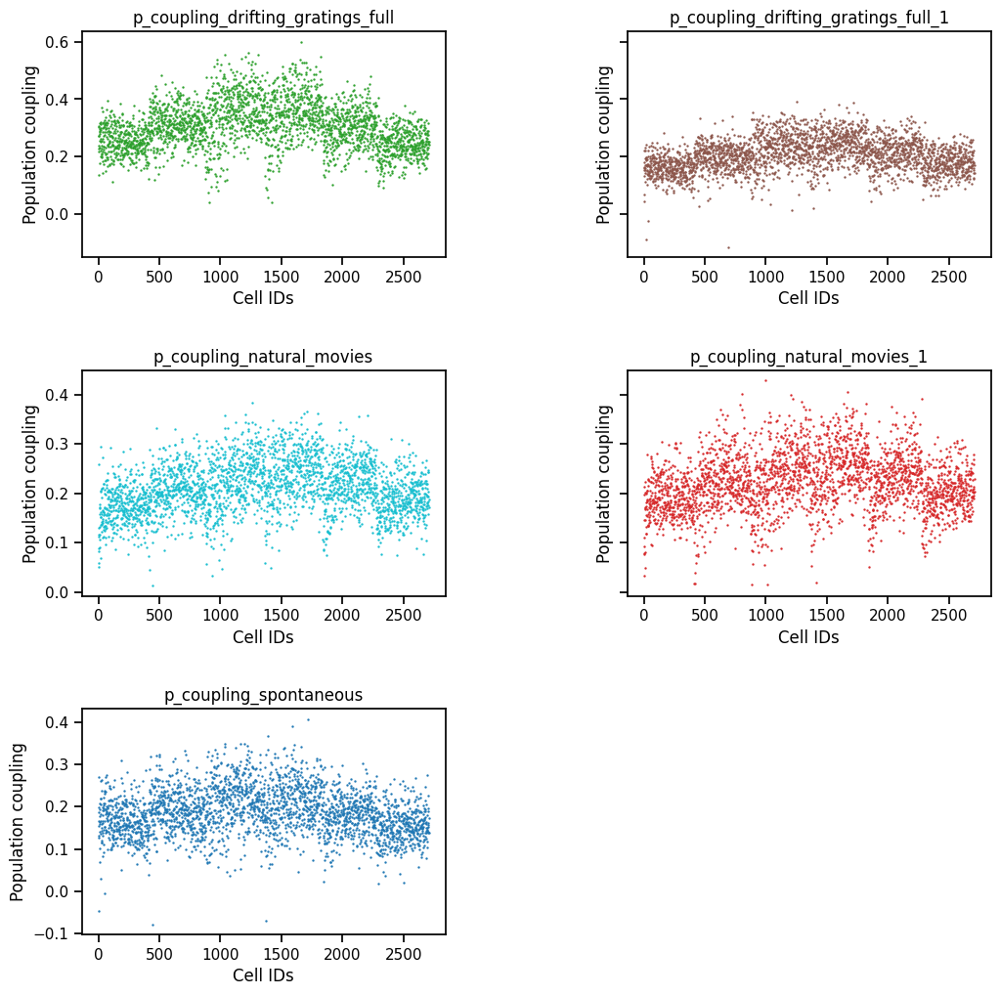

In [19]:
# Plotting all the couling values obtained - AC 

cell_coupling = { 'p_coupling_drifting_gratings_full' : cell_coupling_drifting_gratings_full,'p_coupling_drifting_gratings_full_1' : cell_coupling_drifting_gratings_full_1, 
                 'p_coupling_natural_movies': cell_coupling_natural_movies,
                 'p_coupling_natural_movies_1': cell_coupling_natural_movies_1, 'p_coupling_spontaneous': cell_coupling_spontaneous}


fig, ax = plt.subplots(nrows=3,ncols =2, figsize= (12,12), sharey = 'row')
plt.subplots_adjust(wspace = 0.5, hspace = 0.5)
color_maps = ['tab:green', 'tab:brown', 'tab:cyan', 'tab:red', 'tab:blue', 'tab:orange']

ax=ax.flatten()
for idx, (key,p_coupling) in enumerate(cell_coupling.items()):
    ax[idx].scatter(np.linspace(0,len(p_coupling)-1,len(p_coupling)),p_coupling,s=0.5, c=color_maps[idx])
    ax[idx].set_title(f"{key}")
    ax[idx].set_xlabel("Cell IDs")
    ax[idx].set_ylabel("Population coupling")
    # for x in last_index:
    #     ax[idx].axvline(x)
# Hide the unused subplot
ax[5].axis('off')

[411, 418, 428, 401, 402]
412.0
[440, 433, 438, 427, 442]
436.0


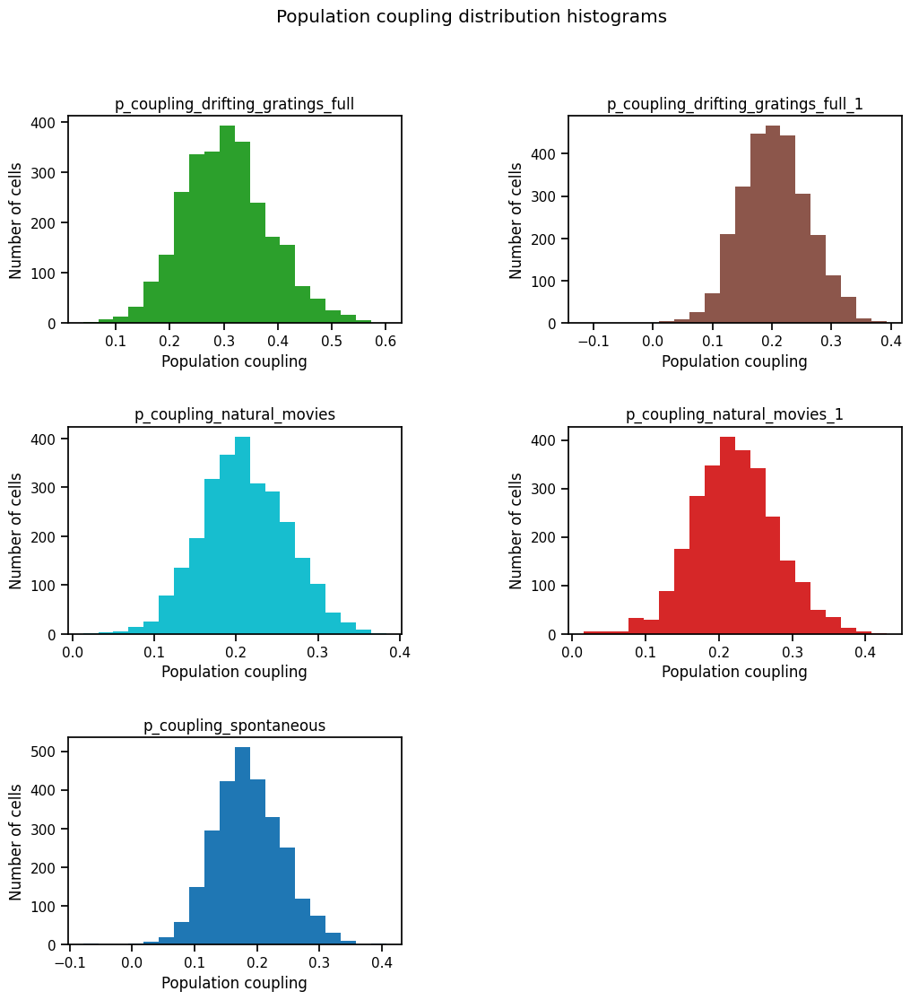

In [20]:
# To plot a histogram of the population coupling distribution and trying to separate out the cells that are coihrists vcs soloists 
fig, ax = plt.subplots(nrows=3,ncols =2, figsize= (12,12))
plt.subplots_adjust(wspace = 0.5, hspace = 0.5)
color_maps = ['tab:green', 'tab:brown', 'tab:cyan', 'tab:red', 'tab:blue', 'tab:orange']
ax = ax.flatten()
soloists_idx=[]
choirists_idx=[]
stimulus_idx=[]
behavior_idx=[]
for idx, (key,p_coupling) in enumerate(cell_coupling.items()):
    ax[idx].hist(p_coupling, bins=20, color = color_maps[idx])
    ax[idx].set_xlabel("Population coupling")
    ax[idx].set_ylabel("Number of cells")
    ax[idx].set_title(f"{key}")
    p_coupling_mean = p_coupling.mean(axis=0)
    p_coupling_std = p_coupling.std(axis=0)
    p_below =p_coupling_mean - p_coupling_std
    p_above = p_coupling_mean+p_coupling_std 
    soloists_idx.append(np.where(p_coupling <= p_below)[0])   # Based on the standard deviation we are splitting cells to choirists and soloists
    choirists_idx.append( np.where(p_coupling >= p_above)[0])
    behavior_idx.append(key)
ax[5].axis('off')
fig.suptitle("Population coupling distribution histograms")
print([len(soloists_idx[i]) for i in range(5)])
print(np.mean([len(soloists_idx[i]) for i in range(5)]))
print([len(choirists_idx[i]) for i in range(5)])
print(np.mean([len(choirists_idx[i]) for i in range(5)]))

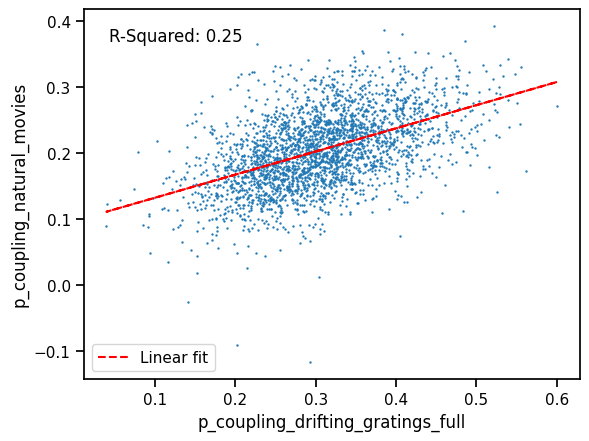

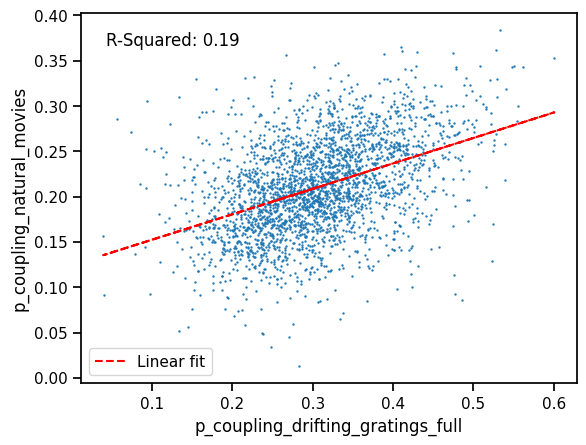

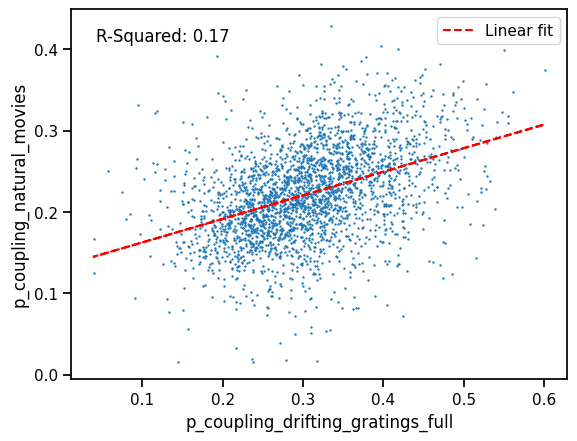

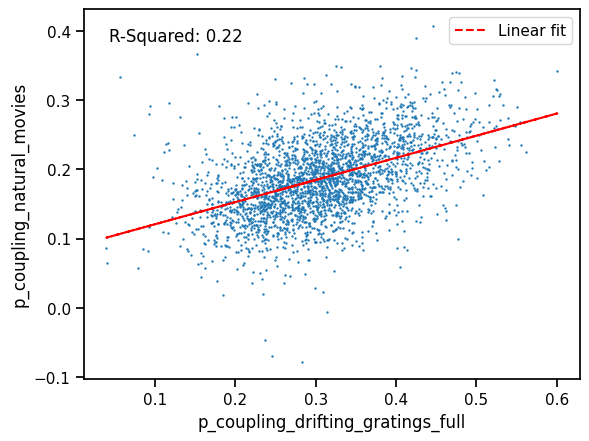

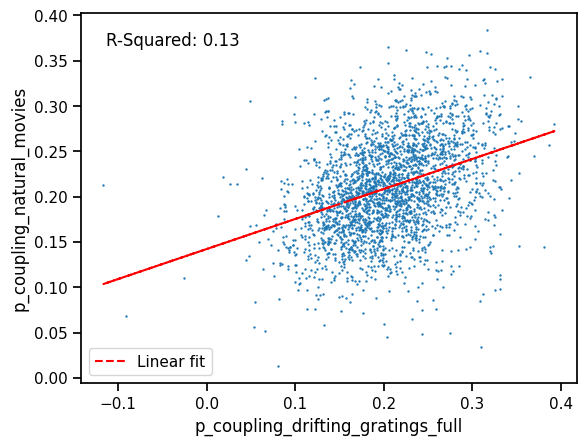

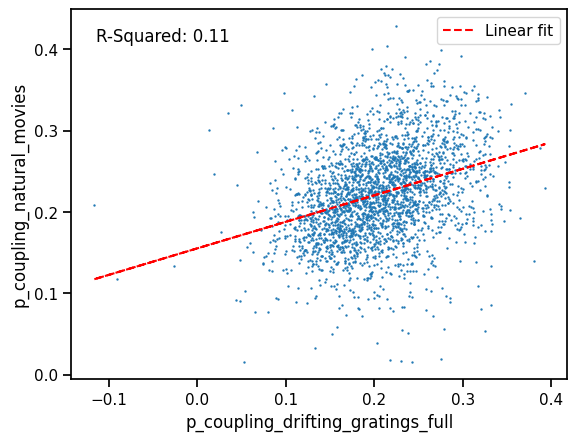

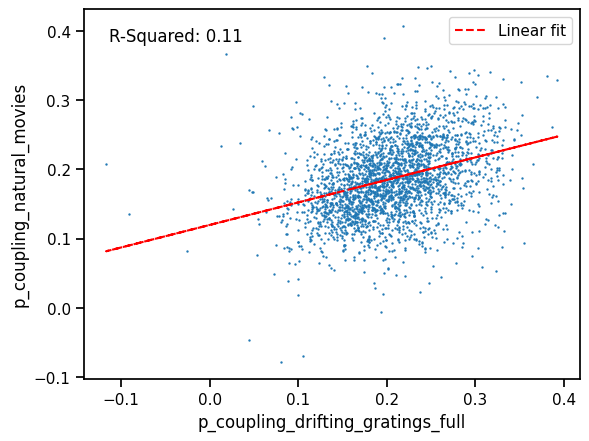

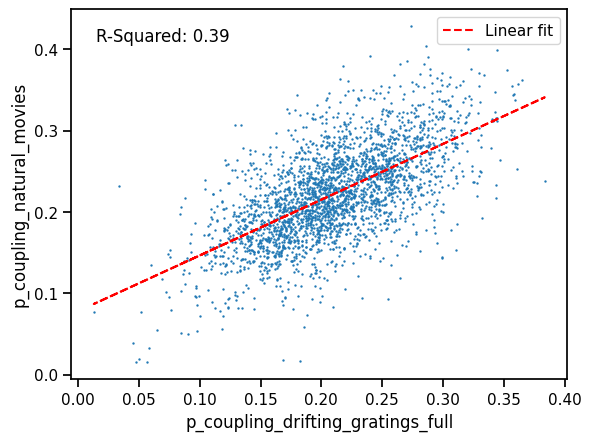

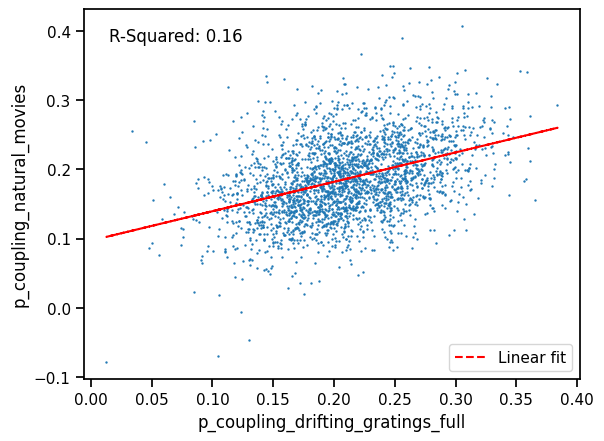

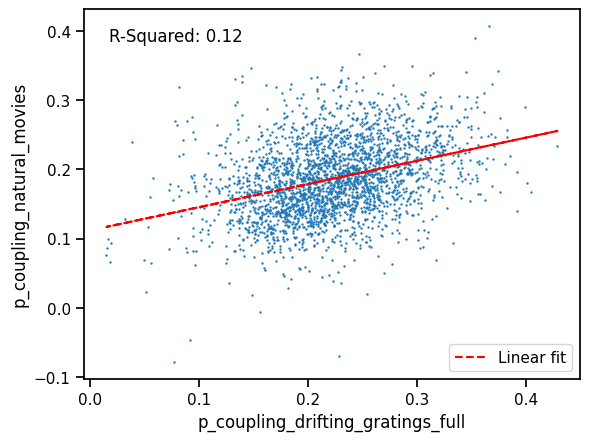

In [373]:
# TO plot the population coupling values across two different epochs 

from scipy.stats import linregress
from sklearn.linear_model import LinearRegression

import itertools



def p_coupling_comparison (first_epoch, second_epoch):
    reg = LinearRegression().fit(x, y)
    regression_line = reg.coef_[0] * x.flatten() + reg.intercept_
    
    axis_lim = max(first_epoch.max(), second_epoch.max()) # To set the max limit 
    # Linear regression
    # slope, intercept, r_value, _, _, _  = linregress(x, y)
    # regression_line = slope * np.array(x) + intercept
    # r2 = r_value ** 2
    r_2 = reg.score(x,y)

    # Plot regression line & the scatter plot 
    plt.figure()
    plt.scatter(x,y,s =0.5, color = 'tab:blue' )
    plt.autoscale(enable=True, axis='both')
    plt.plot(x, regression_line, color='red', linestyle = '--',  label='Linear fit')
    plt.xlabel('p_coupling_drifting_gratings_full')
    plt.ylabel('p_coupling_natural_movies')
    plt.text(0.05, 0.95, f"R-Squared: {r_2:.2f}", transform=plt.gca().transAxes, fontsize=12, verticalalignment='top')
    plt.legend()
    plt.show()

x = cell_coupling['p_coupling_spontaneous']

y = cell_coupling['p_coupling_drifting_gratings_full']

for key1, key2 in itertools.combinations(cell_coupling.keys(), 2):
   
    x = cell_coupling[key1]
    y = cell_coupling[key2]
    #z scored
    x_norm = (x - np.mean(x)) / np.std(x)
    y_norm = (y - np.mean(y)) / np.std(y)
    p_coupling_comparison (x_norm,y_norm)


In [21]:
cell_coupling.keys()

dict_keys(['p_coupling_drifting_gratings_full', 'p_coupling_drifting_gratings_full_1', 'p_coupling_natural_movies', 'p_coupling_natural_movies_1', 'p_coupling_spontaneous'])

In [193]:
dff_dict.keys()

dict_keys(['dff_gratings', 'dff_gratings_2', 'dff_natural_movies_0', 'dff_natural_movies_1', 'dff_spontaneous'])

(2708, 1742)
(2708, 1)
(2708, 1735)
(2708, 1)
(2708, 2725)
(2708, 1)
(2708, 3267)
(2708, 1)
(2708, 1820)
(2708, 1)


Text(0, 0.5, 'Population coupling')

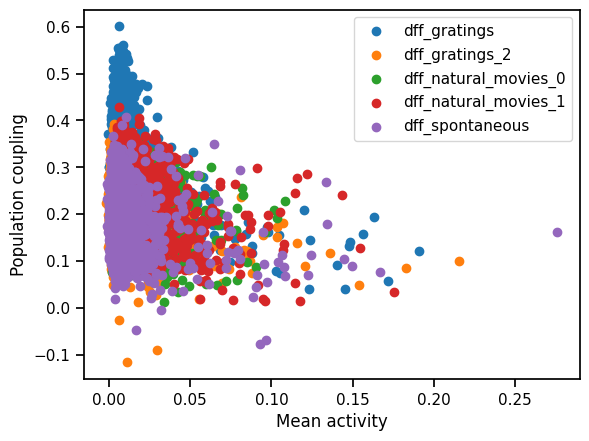

In [22]:
# Scatter plot to show mean firng rate vs population coupling 

for dff_keys, p_coupling_keys in zip(dff_dict.keys(), cell_coupling.keys()):
    dff_per_epoch = dff_dict[dff_keys]
    print(dff_per_epoch.shape)
    p_coupling = cell_coupling[p_coupling_keys]
    print(p_coupling.shape)
    dff_per_epoch_mean = dff_per_epoch.mean(axis=1)
    p_cell_coupling = p_coupling_keys
    plt.scatter(dff_per_epoch_mean,p_coupling)

plt.legend(list(dff_dict.keys()))
plt.xlabel("Mean activity")
plt.ylabel("Population coupling")

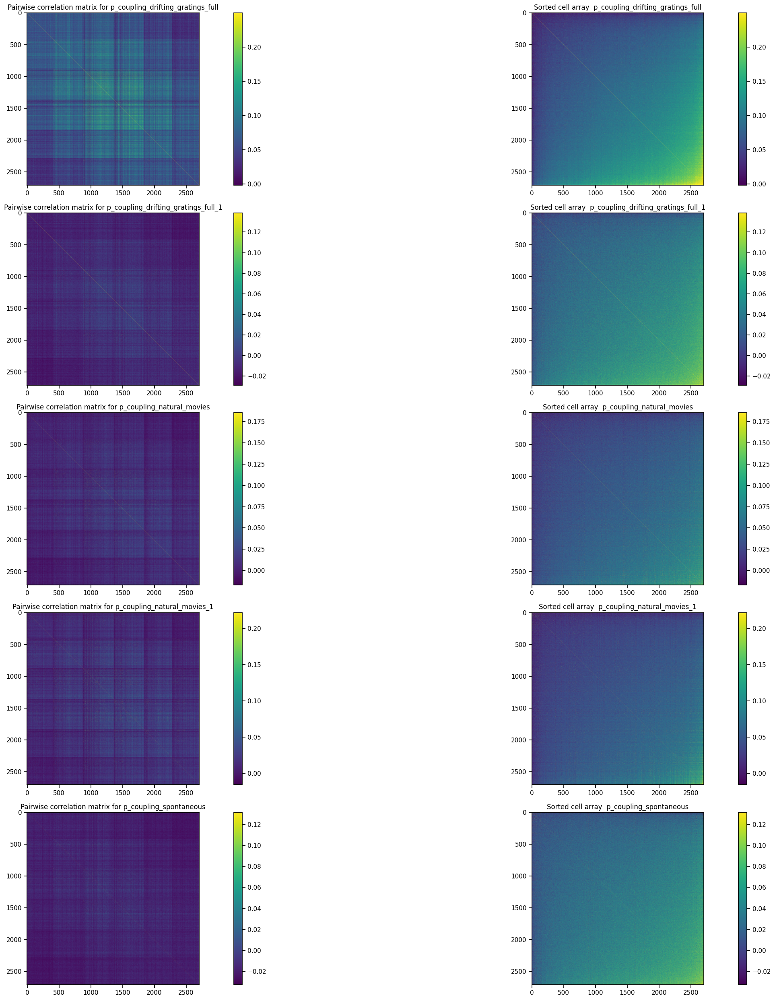

In [23]:
# To plot the pairwise correlation matrix for the cell population vs cell population sorted by population coupling
fig, ax = plt.subplots(nrows=5,ncols =2, figsize= (30,25))
plt.subplots_adjust(wspace = 0.5, hspace = 0.5)
color_maps = ['tab:green', 'tab:brown', 'tab:cyan', 'tab:red', 'tab:blue', 'tab:orange']

dff_key_list = list (dff_dict.keys())
for idx, (key,p_coupling) in enumerate(cell_coupling.items()):
    p_coupling_sorted =np.argsort(p_coupling.flatten())
    
 
    
    dff_sorted = dff_dict[dff_key_list[idx]][p_coupling_sorted,:]
    cross_corr = np.corrcoef(dff_dict[dff_key_list[idx]])
    cross_corr_sorted = np.corrcoef(dff_sorted)
    
    vmin = np.percentile(cross_corr, 1)
    vmax = np.percentile(cross_corr, 99.5)

                                      
    im = ax[idx,0].imshow(cross_corr, vmax=0.3, vmin=0.01, cmap='viridis')
    ax[idx,0].set_title(f"Pairwise correlation matrix for {key}")
    im = ax[idx,1].imshow(cross_corr_sorted, vmax=vmax, vmin=vmin, cmap='viridis')
    ax[idx,1].set_title(f"Sorted cell array  {key}")                    
    plt.colorbar(im, ax=ax[idx,0])
    plt.colorbar(im, ax=ax[idx,1])
plt.tight_layout()
     

(2708, 1742)
(440, 1742)


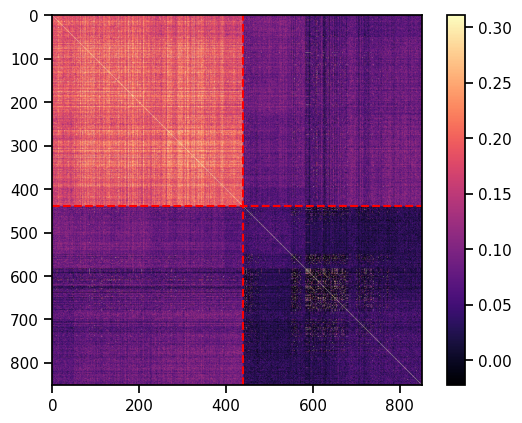

In [26]:
# To plot the pairwise correlation for just the choristers and soloists
dff_subset = dff_dict[dff_key_list[0]]
print(dff_subset.shape)
dff_subset_chorister = dff_subset[choirists_idx[0]]
print(dff_subset_chorister.shape)
n_choristers = dff_subset_chorister.shape[0]
dff_subset = np.vstack([dff_subset_chorister,dff_subset[soloists_idx[0]]])
cross_corr = np.corrcoef(dff_subset)

vmin = np.percentile(cross_corr, 1)
vmax = np.percentile(cross_corr, 99.5)

# Draw horizontal and vertical lines at the boundary
plt.axhline(n_choristers - 0.5, color='red', linestyle='--')
plt.axvline(n_choristers - 0.5, color='red', linestyle='--')

plt.imshow(cross_corr, vmax = vmax, vmin = vmin, cmap ="magma")
plt.colorbar()

# dff_subset = dff_subset.hstack[dff_subset, dff_dict[dff_key_list[0]][soloists_idx[0]]]

(2708, 1735)
(433, 1735)


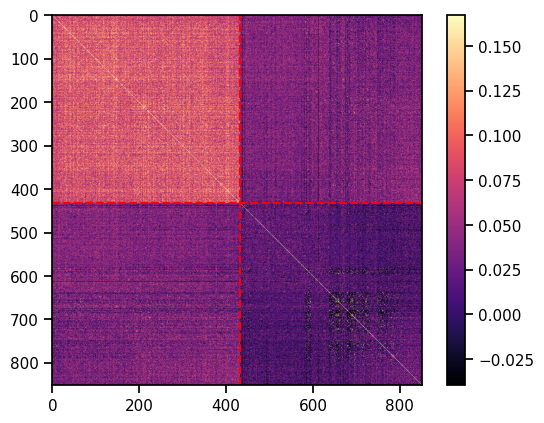

In [27]:
# To plot the pairwise correlation for just the choristers and soloists
dff_subset = dff_dict[dff_key_list[1]]
print(dff_subset.shape)
dff_subset_chorister = dff_subset[choirists_idx[1]]
print(dff_subset_chorister.shape)
n_choristers = dff_subset_chorister.shape[0]
dff_subset = np.vstack([dff_subset_chorister,dff_subset[soloists_idx[1]]])
cross_corr = np.corrcoef(dff_subset)

vmin = np.percentile(cross_corr, 1)
vmax = np.percentile(cross_corr, 99.5)

# Draw horizontal and vertical lines at the boundary
plt.axhline(n_choristers - 0.5, color='red', linestyle='--')
plt.axvline(n_choristers - 0.5, color='red', linestyle='--')

plt.imshow(cross_corr, vmax = vmax, vmin = vmin, cmap ="magma")
plt.colorbar()


(2708, 2725)
(438, 2725)


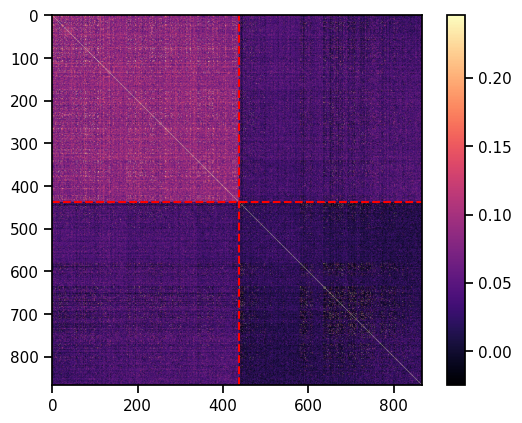

In [28]:
# To plot the pairwise correlation for just the choristers and soloists
dff_subset = dff_dict[dff_key_list[2]]
print(dff_subset.shape)
dff_subset_chorister = dff_subset[choirists_idx[2]]
print(dff_subset_chorister.shape)
n_choristers = dff_subset_chorister.shape[0]
dff_subset = np.vstack([dff_subset_chorister,dff_subset[soloists_idx[2]]])
cross_corr = np.corrcoef(dff_subset)

vmin = np.percentile(cross_corr, 1)
vmax = np.percentile(cross_corr, 99.5)

# Draw horizontal and vertical lines at the boundary
plt.axhline(n_choristers - 0.5, color='red', linestyle='--')
plt.axvline(n_choristers - 0.5, color='red', linestyle='--')

plt.imshow(cross_corr, vmax = vmax, vmin = vmin, cmap ="magma")
plt.colorbar()

(2708, 3267)
(427, 3267)


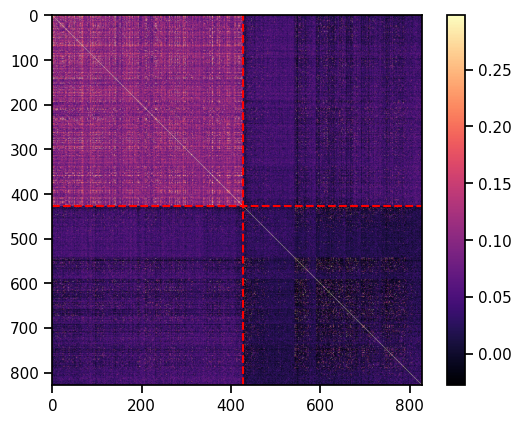

In [29]:
# To plot the pairwise correlation for just the choristers and soloists
dff_subset = dff_dict[dff_key_list[3]]
print(dff_subset.shape)
dff_subset_chorister = dff_subset[choirists_idx[3]]
print(dff_subset_chorister.shape)
n_choristers = dff_subset_chorister.shape[0]
dff_subset = np.vstack([dff_subset_chorister,dff_subset[soloists_idx[3]]])
cross_corr = np.corrcoef(dff_subset)

vmin = np.percentile(cross_corr, 1)
vmax = np.percentile(cross_corr, 99.5)

# Draw horizontal and vertical lines at the boundary
plt.axhline(n_choristers - 0.5, color='red', linestyle='--')
plt.axvline(n_choristers - 0.5, color='red', linestyle='--')

plt.imshow(cross_corr, vmax = vmax, vmin = vmin, cmap ="magma")
plt.colorbar()

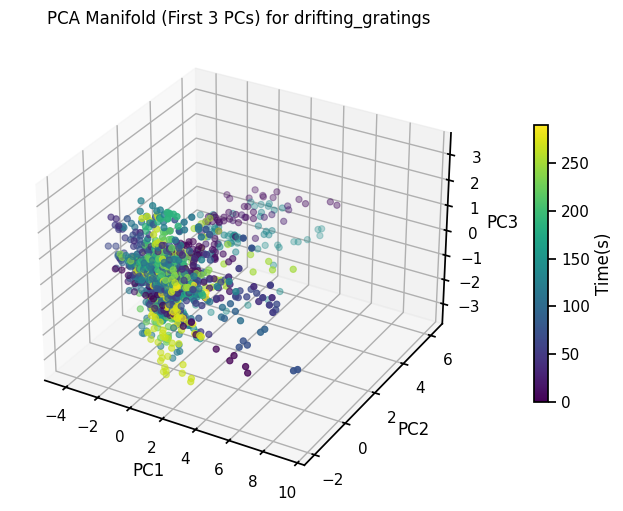

NameError: name 'pca_results' is not defined

In [32]:
# To calculate the PCA manifold for the dff data for each epoch 

from sklearn.decomposition import PCA
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D



dff_epoch = dff_dict[dff_key_list[0]].T # shape: (n_timepoints, n_cells)
pca = PCA(n_components= 10**3)
pca_result = pca.fit_transform(dff_epoch)  

fig = plt.figure(figsize=(8, 6))
ax = fig.add_subplot(111, projection='3d')

explained_fraction = pca.explained_variance_ / np.sum(pca.explained_variance_)

im = ax.scatter3D(pca_result[:, 0], pca_result[:, 1], pca_result[:, 2], lw=0.8,c=np.arange(dff_epoch.shape[0])/6)
ax.set_xlabel('PC1')
ax.set_ylabel('PC2')
ax.set_zlabel('PC3')
ax.set_title(f'PCA Manifold (First 3 PCs) for drifting_gratings ')


# Add colorbar
fig = plt.gcf()  # Get current figure
cbar = fig.colorbar(im, ax=ax, pad=0.1, shrink=0.6)
cbar.set_label('Time(s)')  # Set label as appropriate
plt.show()

print(pca_results[:,1].shape)
# To plot the explained variance 
plt.figure()
plt.plot(np.arange(1, len(explained_fraction)+1), explained_fraction, marker='o')
plt.xlabel('Principal Component')
plt.ylabel('Variance')
plt.title('Eigen Spectrum')
plt.xscale('log')
plt.yscale('log')
plt.show()


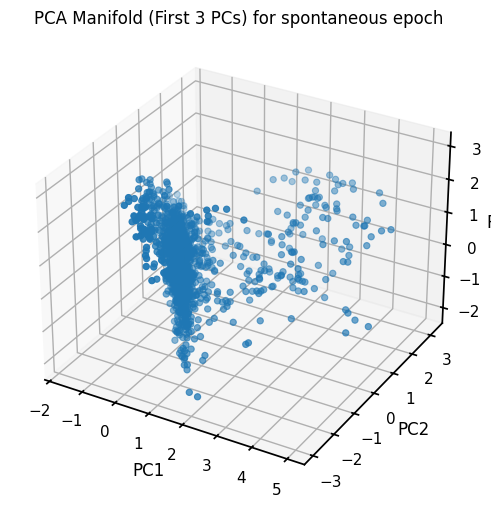

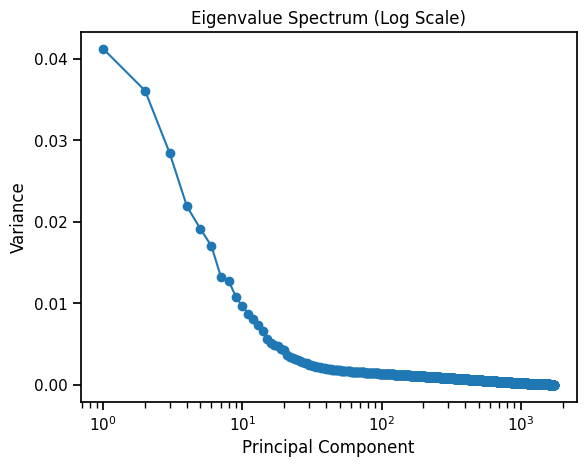

In [243]:
# To calculate the PCA manifold for the dff data for each epoch 

from sklearn.decomposition import PCA
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D



dff_epoch = dff_dict[dff_key_list[1]].T # shape: (n_timepoints, n_cells)
pca = PCA()
pca_result = pca.fit_transform(dff_epoch)  

fig = plt.figure(figsize=(8, 6))
ax = fig.add_subplot(111, projection='3d')

explained_fraction = pca.explained_variance_ / np.sum(pca.explained_variance_)

ax.scatter3D(pca_result[:, 0], pca_result[:, 1], pca_result[:, 2], lw=0.8)
ax.set_xlabel('PC1')
ax.set_ylabel('PC2')
ax.set_zlabel('PC3')
ax.set_title(f'PCA Manifold (First 3 PCs) for spontaneous epoch ')
plt.show()

# To plot the explained variance 
plt.figure()
plt.plot(np.arange(1, len(explained_fraction)+1), explained_fraction, marker='o')
plt.xlabel('Principal Component')
plt.ylabel('Variance')
plt.title('Eigenvalue Spectrum (Log Scale)')
plt.xscale('log')
plt.yscale('log')
plt.show()


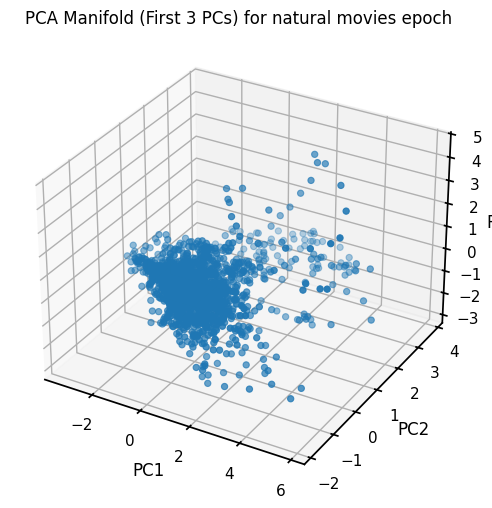

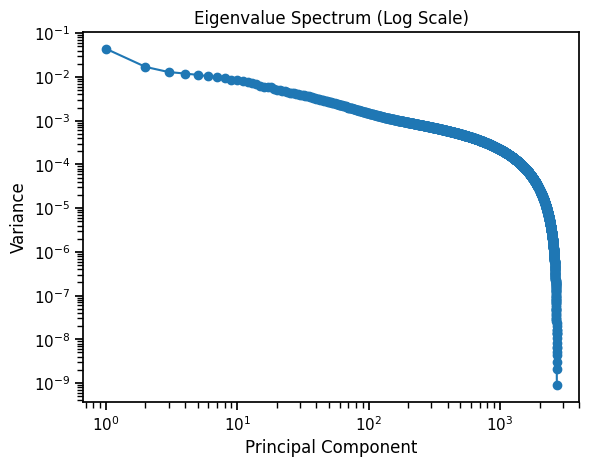

In [271]:
# To calculate the PCA manifold for the dff data for each epoch 

from sklearn.decomposition import PCA
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D



dff_epoch = dff_dict[dff_key_list[2]].T # shape: (n_timepoints, n_cells)
pca = PCA()
pca_result = pca.fit_transform(dff_epoch)  

fig = plt.figure(figsize=(8, 6))
ax = fig.add_subplot(111, projection='3d')

explained_fraction = pca.explained_variance_ / np.sum(pca.explained_variance_)

ax.scatter3D(pca_result[:, 0], pca_result[:, 1], pca_result[:, 2], lw=0.8)
ax.set_xlabel('PC1')
ax.set_ylabel('PC2')
ax.set_zlabel('PC3')
ax.set_title(f'PCA Manifold (First 3 PCs) for natural movies epoch ')
plt.show()

# To plot the explained variance 
plt.figure()
plt.plot(np.arange(1, len(explained_fraction)+1), explained_fraction, marker='o')
plt.xlabel('Principal Component')
plt.ylabel('Variance')
plt.title('Eigenvalue Spectrum (Log Scale)')
plt.xscale('log')
plt.yscale('log')
plt.show()

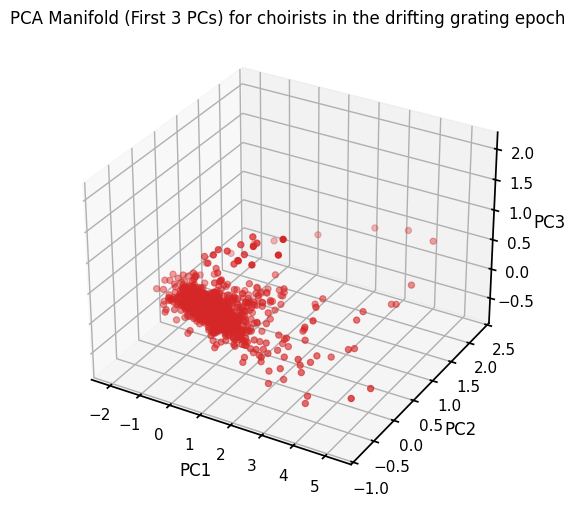

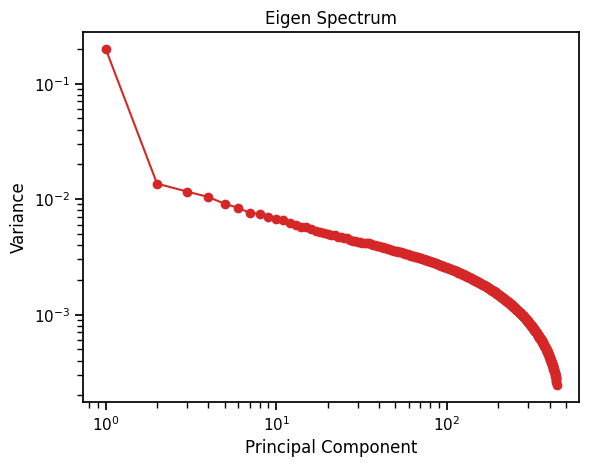

In [376]:
# To calculate the PCA manifold for the dff data for each epoch (choirists)

from sklearn.decomposition import PCA
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D

dff_epoch = dff_dict[dff_key_list[0]].T # shape: (n_timepoints, n_cells)

dff_epoch_choir = dff_epoch[:,choirists_idx[0]]
pca = PCA()
pca_result = pca.fit_transform(dff_epoch_choir)  

fig = plt.figure(figsize=(8, 6))
ax = fig.add_subplot(111, projection='3d')

explained_fraction = pca.explained_variance_ / np.sum(pca.explained_variance_)

ax.scatter3D(pca_result[:, 0], pca_result[:, 1], pca_result[:, 2], lw=0.8, color="tab:red")
ax.set_xlabel('PC1')
ax.set_ylabel('PC2')
ax.set_zlabel('PC3')
ax.set_title('PCA Manifold (First 3 PCs) for choirists in the drifting grating epoch')
plt.show()

# To plot the explained variance 
plt.figure()
plt.plot(np.arange(1, len(explained_fraction)+1), explained_fraction, marker='o', c="tab:red")
plt.xlabel('Principal Component')
plt.ylabel('Variance')
plt.title('Eigen Spectrum')
plt.xscale('log')
plt.yscale('log')
plt.show()

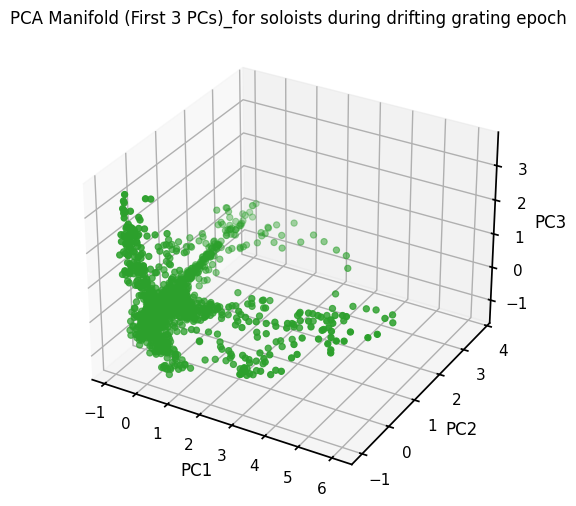

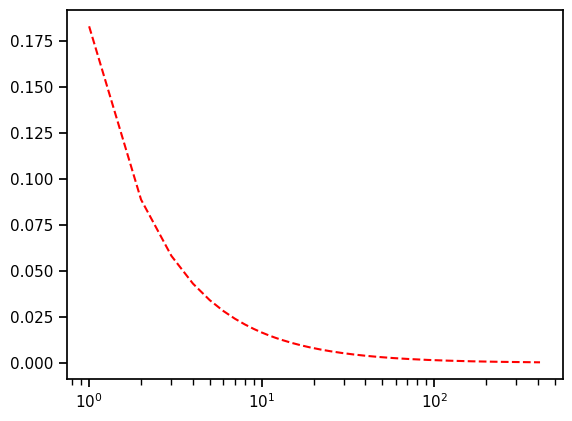

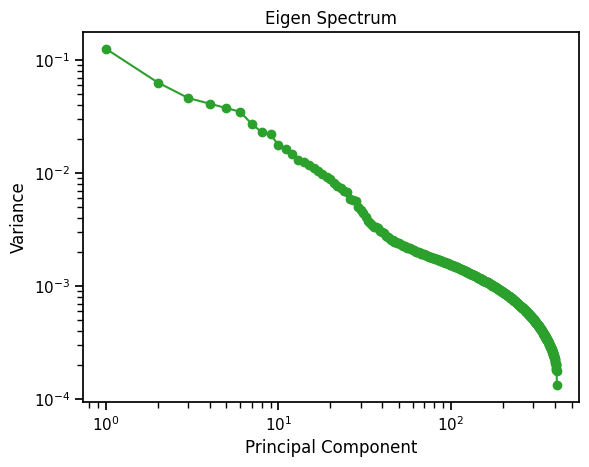

In [377]:
# To calculate the PCA manifold for the dff data for each epoch (choirists)

from sklearn.decomposition import PCA
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D

dff_epoch = dff_dict[dff_key_list[0]].T # shape: (n_timepoints, n_cells)

dff_epoch_choir = dff_epoch[:,soloists_idx[0]]
pca = PCA()
pca_result = pca.fit_transform(dff_epoch_choir)  

fig = plt.figure(figsize=(8, 6))
ax = fig.add_subplot(111, projection='3d')

explained_fraction = pca.explained_variance_ / np.sum(pca.explained_variance_)

ax.scatter3D(pca_result[:, 0], pca_result[:, 1], pca_result[:, 2], lw=0.8, c="tab:green")
ax.set_xlabel('PC1')
ax.set_ylabel('PC2')
ax.set_zlabel('PC3')
ax.set_title('PCA Manifold (First 3 PCs)_for soloists during drifting grating epoch')
plt.show()

# To plot the explained variance 
# Take log of x and y
log_x = np.log10(np.arange(1, len(explained_fraction)+1))
log_y = np.log10(explained_fraction)
# Fit a line: log_y = alpha * log_x + intercept
alpha, intercept = np.polyfit(log_x, log_y, 1)

# Plot the fitted line
fitted_line = 10**(alpha * log_x + intercept)
plt.plot(np.arange(1, len(explained_fraction)+1), fitted_line, 'r--', label=f'Fit: alpha={alpha:.2f}')
plt.xscale('log')
plt.figure()
plt.plot(np.arange(1, len(explained_fraction)+1), explained_fraction, marker='o',c="tab:green")
plt.xlabel('Principal Component')
plt.ylabel('Variance')
plt.title('Eigen Spectrum')
plt.xscale('log')
plt.yscale('log')
plt.show()

AttributeError: 'PCA' object has no attribute 'result'

NameError: name 'sc' is not defined

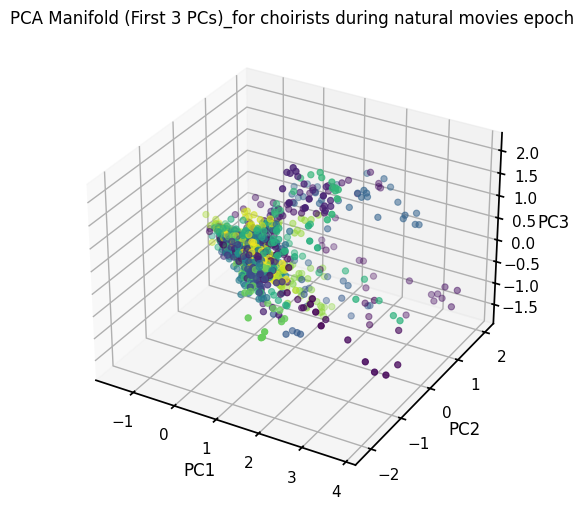

In [24]:
# To calculate the PCA manifold for the dff data for each epoch (choirists)

from sklearn.decomposition import PCA
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D

dff_epoch = dff_dict[dff_key_list[2]].T # shape: (n_timepoints, n_cells)

dff_epoch_choir = dff_epoch[:,choirists_idx[2]]
pca = PCA()
pca_result = pca.fit_transform(dff_epoch_choir)  

fig = plt.figure(figsize=(8, 6))
ax = fig.add_subplot(111, projection='3d')

explained_fraction = pca.explained_variance_ / np.sum(pca.explained_variance_)

ax.scatter3D(pca_result[:, 0], pca_result[:, 1], pca_result[:, 2], lw=0.8,c=np.arange(dff_epoch_choir.shape[0])/6)
ax.set_xlabel('PC1')
ax.set_ylabel('PC2')
ax.set_zlabel('PC3')
ax.set_title('PCA Manifold (First 3 PCs)_for choirists during natural movies epoch')


# Add colorbar
fig = plt.gcf()  # Get current figure
cbar = fig.colorbar(sc, ax=ax, pad=0.1, shrink=0.6)
cbar.set_label('Time(s)')  # Set label as appropriate
plt.show()

# To plot the explained variance 
plt.figure()
plt.plot(np.arange(1, len(explained_fraction)+1), explained_fraction, marker='o', c="tab:red")
plt.xlabel('Principal Component')
plt.ylabel('Variance')
plt.title('PCA Eigenvalue Spectrum (Log Scale)')
plt.xscale('log')
plt.show()

loadings = pca.components_
# for i, loading_val in enumerate(loadings[0]):
#     print(f"Feature{ i+1}: {loading_val:.4f}")
# To plot the contribution of individual features to PC1
plt.figure()

fig,axs = plt.subplots(nrows=1, ncols=4, figsize = (24,6))
axs=axs.flatten()
for i in range(4):
    axs[i].hist(loadings[i], bins =40)
    

In [284]:
dff_epoch.shape


(2725, 2708)

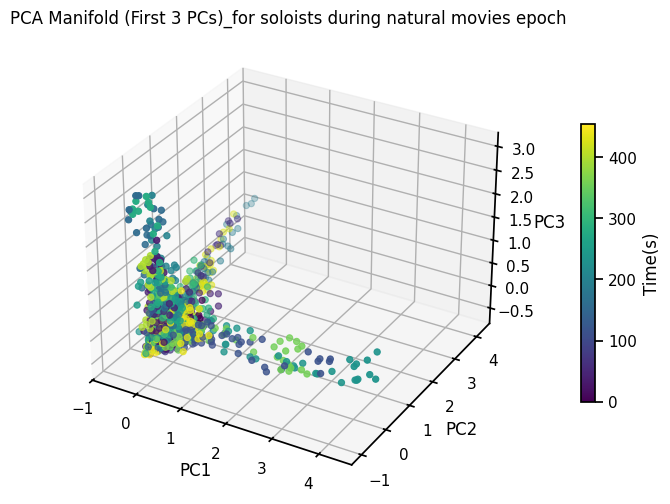

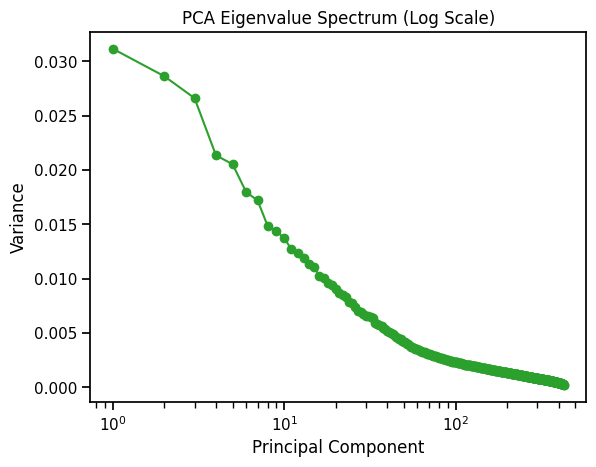

<Figure size 640x480 with 0 Axes>

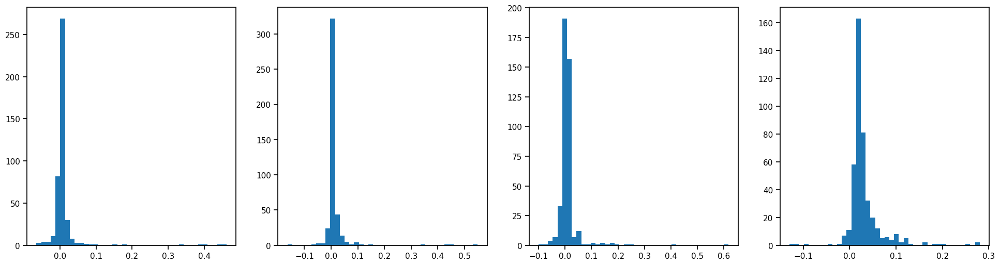

In [298]:
# To calculate the PCA manifold for the dff data for each epoch (choirists)

from sklearn.decomposition import PCA
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D

dff_epoch = dff_dict[dff_key_list[2]].T # shape: (n_timepoints, n_cells)

dff_epoch_choir = dff_epoch[:,soloists_idx[2]]
pca = PCA()
pca_result = pca.fit_transform(dff_epoch_choir)  

fig = plt.figure(figsize=(8, 6))
ax = fig.add_subplot(111, projection='3d')

explained_fraction = pca.explained_variance_ / np.sum(pca.explained_variance_)



sc = ax.scatter3D(pca_result[:, 0], pca_result[:, 1], pca_result[:, 2], lw=0.8, c=np.arange(dff_epoch_choir.shape[0])/6)
ax.set_xlabel('PC1')
ax.set_ylabel('PC2')
ax.set_zlabel('PC3')
ax.set_title('PCA Manifold (First 3 PCs)_for soloists during natural movies epoch')
# Add colorbar
fig = plt.gcf()  # Get current figure
cbar = fig.colorbar(sc, ax=ax, pad=0.1, shrink=0.6)
cbar.set_label('Time(s)')  # Set label as appropriate
plt.show()



# To plot the explained variance 
plt.figure()
plt.plot(np.arange(1, len(explained_fraction)+1), explained_fraction, marker='o', c="tab:green")
plt.xlabel('Principal Component')
plt.ylabel('Variance')
plt.title('PCA Eigenvalue Spectrum (Log Scale)')
plt.xscale('log')
plt.show()


loadings = pca.components_
# for i, loading_val in enumerate(loadings[0]):
#     print(f"Feature{ i+1}: {loading_val:.4f}")
# To plot the contribution of individual features to PC1
plt.figure()

fig,axs = plt.subplots(nrows=1, ncols=4, figsize = (24,6))
axs=axs.flatten()
for i in range(4):
    axs[i].hist(loadings[i], bins =40)
    



In [274]:
# tt_result = scipy.stats.ttest_ind(list_of_dff_by_condition[3], baseline_dff, equal_var=False)
is_significant = []
p_values = []
n_trials = []
for dff in list_of_dff_by_condition:
    _, pvalue = scipy.stats.mannwhitneyu(
        dff, baseline_dff,
        alternative='greater',  # is neuron response significantly greater than baseline?
        method='exact',  # recommended when there are no ties and when either sample size < 8
    )

    p_values.append(pvalue)
    n_trials.append(dff.size)
    # Bonferonni correction. Much more conservative, but seems more consistent
    is_significant.append(pvalue < (0.05 / dff.size))

    # BH-FDR correction. More relaxed, picking up on activities that idk
    # qvalue = scipy.stats.false_discovery_control(pvalue)
    # is_significant.append(qvalue < 0.01)

p_values = np.array(p_values).T
n_trials = np.array(n_trials).T
is_significant = np.array(is_significant).T
p_values.shape, n_trials.shape, is_significant.shape


    

NameError: name 'list_of_dff_by_condition' is not defined

In [28]:
# To create a dataframe for choirists and soloists 
results=[]
selected_session_data.keys()
cell_class_table =pd.DataFrame({
    'plane_ids': selected_session_data['plane_ids'],
    'roi_ids': selected_session_data['roi_ids']
})


cell_class_table['cell_class'] = np.nan  # default to 0
for idx, (key,p_coupling) in enumerate(cell_coupling.items()):

    temp_df = cell_class_table.copy()
    
    temp_df.loc[soloists_idx[idx], 'cell_class'] = 1
    temp_df.loc[choirists_idx[idx], 'cell_class'] = 0
    temp_df['p_coupling_value'] = p_coupling
    temp_df['stimulus'] = key
    results.append(temp_df)
final_df = pd.concat(results, ignore_index=True)

final_df['cell_class'].value_counts(dropna = False)
# TO save the dataframe to metadata folder
final_df.to_csv('/data/volume3_cell_class.csv', index=False)
print(final_df[final_df['stimulus'] == '*spontaneous']['cell_class'].value_counts(dropna = False).sum())
final_df['stimulus'].unique()

NameError: name 'selected_session_data' is not defined

In [33]:
list_of_epoch_data[1].keys()

dict_keys(['timestamps', 'dff_traces', 'roi_ids', 'plane_ids', 'volume_ids', 'column_ids', 'behavior_traces', 'behavior_names'])

In [36]:
# To create a dataframe for choirists and soloists 
results=[]

cell_class_table = pd.DataFrame(columns=['column_id','volume_id', 'plane_ids', 'roi_ids', 'cell_class', ])

for epoch_set in list_of_epoch_data: 
    row_dict = {
        'column_id': epoch_set['column_ids'],
        'volume_id': epoch_set['volume_ids'],
        'plane_ids': epoch_set['plane_ids'],
        'roi_ids': epoch_set['roi_ids'],
       
    }
    cell_class_table = pd.concat([cell_class_table, pd.DataFrame([row_dict])], ignore_index=True)                                    

5

In [30]:
cell_class_table['cell_class'] = np.nan  # default to 0
for idx, (key,p_coupling) in enumerate(cell_coupling.items()):

    temp_df = cell_class_table.copy()
    temp_df.loc[soloists_idx[idx], 'cell_class'] = 1
    temp_df.loc[choirists_idx[idx], 'cell_class'] = 0
    temp_df['p_coupling_value'] = p_coupling
    temp_df['stimulus'] = key
    results.append(temp_df)

final_df = pd.concat(results, ignore_index=True)

final_df['cell_class'].value_counts(dropna = False)
# TO save the dataframe to metadata folder
final_df.to_csv('/data/volume3_cell_class.csv', index=False)
print(final_df[final_df['stimulus'] == '*spontaneous']['cell_class'].value_counts(dropna = False).sum())
final_df['stimulus'].unique()

KeyError: "None of [Index([   5,    7,   14,   16,   23,   25,   26,   29,   31,   34,\n       ...\n       2673, 2676, 2680, 2685, 2687, 2689, 2695, 2696, 2697, 2701],\n      dtype='int64', length=411)] are in the [index]"

In [2]:
# Code to plot random traces from different DFF traces 

fig, axs = plt.subplots(nrows = 2, ncols =2 , figsize=(30,30))
axs = axs.flatten()  # make it easy to index

dff_dict = {'dff_gratings' : dff_drifting_gratings_0, 'dff_gratings_2' : dff_drifting_gratings_1, 'dff_natural_movies_0' : dff_natural_movies_0, 'dff_natural_movies_1' : dff_natural_movies_1, 'dff_spontaneous' : dff_spontaneous}


np.random.seed(42) 
twenty_random_traces = np.random.randint(1,dff_dict['dff_gratings'].shape[0],20)
offset = np.arange(0,20)
offset = 0.5 * offset.reshape(-1,1)
for idx,(name,i) in enumerate (dff_dict.items()):
    print(i.shape)
    axs[idx].plot((i[twenty_random_traces ,0:800]+offset).T)
    axs[idx].set_title(f"DFF traces for {name}")
    
  

NameError: name 'plt' is not defined

In [53]:
selected_session_data['dff_traces'].shape

(2708, 11289)

In [88]:
sorting_off

array([ 906, 1424, 1392, ..., 1305, 1225, 1657])

In [186]:
cell_coupling.keys()

dict_keys(['p_coupling_drifting_gratings_full', 'p_coupling_drifting_gratings_full_1', 'p_coupling_natural_movies', 'p_coupling_natural_movies_1', 'p_coupling_spontaneous'])

In [184]:
dff_dict.keys()

dict_keys(['dff_gratings', 'dff_gratings_2', 'dff_natural_movies_0', 'dff_natural_movies_1', 'dff_spontaneous'])

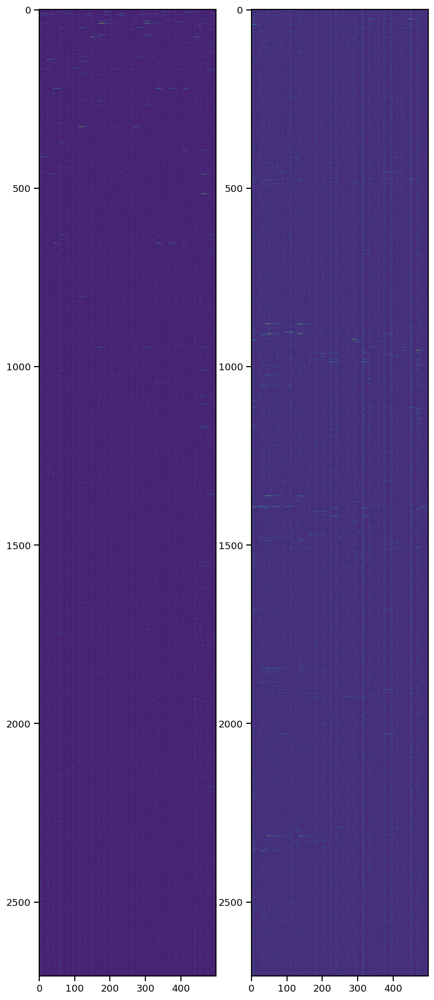

In [185]:
# To sort cells based on their population coupling 
sorting_off = np.argsort(cell_coupling['p_coupling_drifting_gratings_full_1'].flatten())
dff_sort = dff_dict['dff_gratings_2'][sorting_off]
fig, axs = plt.subplots(1,2, figsize=(8,20), dpi =120)
axs[0].imshow(dff_sort[:, 0:500], aspect='auto')
axs[1].imshow(dff_dict['dff_gratings'][:, 0:500], aspect='auto')

In [114]:
choirists_idx[0]

array([  78,  420,  428,  443,  445,  446,  451,  457,  463,  466,  470,
        473,  480,  500,  517,  551,  559,  584,  599,  602,  608,  624,
        627,  632,  636,  642,  643,  644,  648,  651,  656,  660,  664,
        665,  667,  670,  674,  690,  696,  699,  722,  725,  726,  737,
        739,  742,  779,  791,  807,  812,  847,  881,  883,  886,  887,
        892,  897,  905,  919,  925,  933,  934,  936,  938,  940,  948,
        951,  952,  958,  960,  961,  964,  969,  970,  974,  975,  976,
        983,  984,  987,  991, 1000, 1001, 1003, 1004, 1005, 1008, 1011,
       1017, 1021, 1024, 1025, 1027, 1029, 1032, 1034, 1035, 1036, 1037,
       1040, 1042, 1043, 1051, 1052, 1054, 1062, 1064, 1065, 1066, 1068,
       1069, 1071, 1072, 1081, 1082, 1083, 1086, 1088, 1091, 1098, 1100,
       1103, 1104, 1107, 1108, 1109, 1110, 1117, 1120, 1122, 1123, 1130,
       1133, 1135, 1137, 1138, 1139, 1141, 1142, 1149, 1150, 1151, 1152,
       1153, 1154, 1155, 1156, 1158, 1162, 1165, 11

(88, 1742)


NameError: name 'name' is not defined

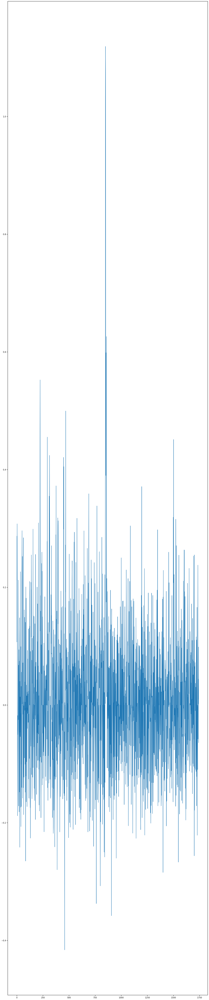

In [179]:

# dff_choirists = dff_dict['dff_gratings'][choirists_idx[0]]
# dff_soloists = dff_dict['dff_gratings'][soloists_idx[0]]
# # Compute the mean for each cell (assuming cells are rows)
# cell_means = dff_choirists.mean(axis=1)

# # Find the 80th percentile threshold
# threshold = np.percentile(cell_means, 80)

# # Select cells with mean above the 80th percentile
# top_cells_mask = cell_means > threshold
# dff_choirists_top80 = dff_choirists[top_cells_mask]

# offset_choirists = 0.5 * np.arange(dff_choirists_top80.shape[0]).reshape(-1, 1)

# print(dff_choirists_top80.shape)
# plt.figure(figsize=(20, 100))
# for idx,i in enumerate(dff_choirists_top80):
#     plt.plot((i+offset_choirists[idx]).T)
#     plt.title(f"DFF traces for top 80 ")




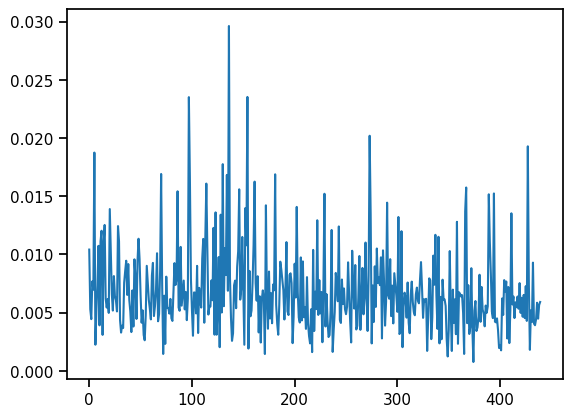

In [178]:
plt.plot(np.mean(dff_choirists, axis =1))

In [92]:
stim_epochs_df

,stim_name,start_time,stop_time,duration
0,drifting_gratings_full,54.634430,341.856873,287.222443
1,spontaneous,876.318604,1176.552002,300.233398
2,natural_movie,1343.707764,1794.066162,450.358398
3,drifting_gratings_full,2704.841309,2992.063721,287.222412
4,natural_movie,2997.084473,3537.517822,540.433350


In [93]:
cell_coupling.keys()

dict_keys(['p_coupling_drifting_gratings_full', 'p_coupling_drifting_gratings_full_1', 'p_coupling_natural_movies', 'p_coupling_natural_movies_1', 'p_coupling_spontaneous'])

In [201]:
# TO create a cell_class dataframe and save it 

rows = []
stimulus = ["p_coupling_drifting_gratings_full", "p_coupling_spontaneous", "p_coupling_natural_movies", "p_coupling_drifting_gratings_full_1", "p_coupling_natural_movies_1"]
results = []
for idx, epoch in enumerate(list_of_epoch_data):
    plane_ids = epoch['plane_ids']
    roi_ids = epoch['roi_ids']
    dff_means = epoch['dff_traces'].T.mean(axis=1)  # Adjust as needed
    dff_peak = epoch['dff_traces'].T.max(axis=1) # To calculate the peak DFF value for each neuron traces
    stimulus_tray = [stimulus[idx]]* len(epoch['plane_ids'])
    # Optionally, get cell_class and P_values if available
    cell_classes = epoch.get('cell_class', [None]*len(plane_ids))
    p_values = epoch.get('P_values', [None]*len(plane_ids))
    
    for i in range(len(plane_ids)):
        row = {
            "plane": plane_ids[i],
            "roi": roi_ids[i],
            "dff_mean": dff_means[i] if hasattr(dff_means, '__getitem__') else dff_means,
            "dff_peak": dff_peak[i] if hasattr(dff_means, '__getitem__') else dff_means,
            "cell_class": cell_classes[i] if hasattr(cell_classes, '__getitem__') else cell_classes,
            "p_values": p_values[i] if hasattr(p_values, '__getitem__') else p_values,
            "stimulus" : stimulus_tray[i] 
        }
        rows.append(row)

cell_class_df = pd.DataFrame(rows, columns=["plane", "roi", "dff_mean","dff_peak", "cell_class","p_values", "stimulus"])
cell_class_df.head()
for idx, (key,p_coupling) in enumerate(cell_coupling.items()):

    temp_df = cell_class_df[cell_class_df['stimulus'] == key].reset_index(drop = True)
    temp_df.loc[soloists_idx[idx], 'cell_class'] = 1
    temp_df.loc[choirists_idx[idx], 'cell_class'] = 0
    temp_df['p_values'] = p_coupling
    temp_df['stimulus'] = key
    results.append(temp_df)


results = pd.concat(results)
results.to_csv('vol3_pcoupling_v2.csv', index=False)

(2708,)

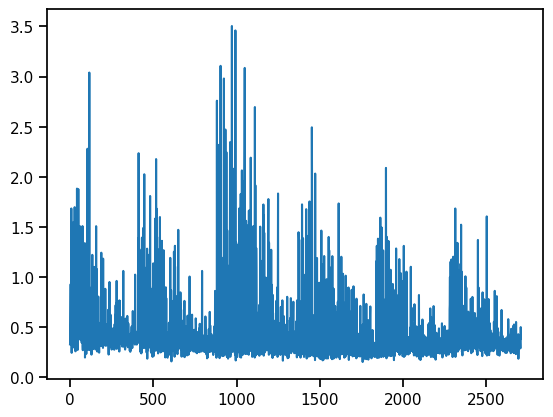

In [210]:
plt.plot(results[results['stimulus'] == 'p_coupling_spontaneous']['dff_peak'])
dff_peak.shape

In [348]:
dff_dict.keys()

dict_keys(['dff_gratings', 'dff_gratings_2', 'dff_natural_movies_0', 'dff_natural_movies_1', 'dff_spontaneous'])

(2708, 1742)
(99, 1742)


(-3.963010923572937, 77.70291564063461)

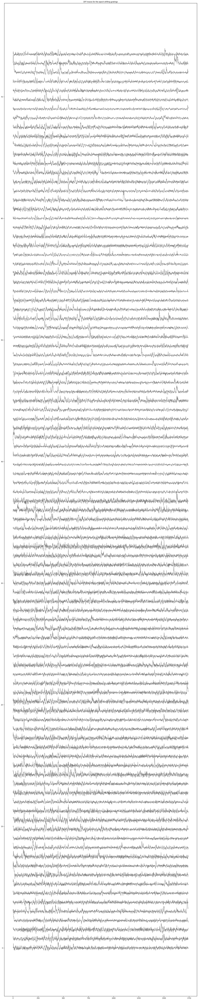

In [360]:

print(dff_dict['dff_gratings'].shape)
dff_choirists = dff_dict['dff_gratings'][choirists_idx[0]][1:100]
dff_soloists = dff_dict['dff_gratings'][soloists_idx[0]][1:100]
offset_choirists = 0.75 * np.arange(dff_choirists.shape[0]).reshape(-1, 1)
print(dff_choirists.shape)
plt.figure(figsize=(20, 100))
for idx,i in enumerate(dff_choirists):
    plt.plot((i+offset_choirists[idx]), color = "tab:gray")
    plt.title(f"DFF traces for the epoch drifting gratings")
plt.tight_layout()
plt.ylim(auto=True) 

(2708, 1735)
(100, 1735)


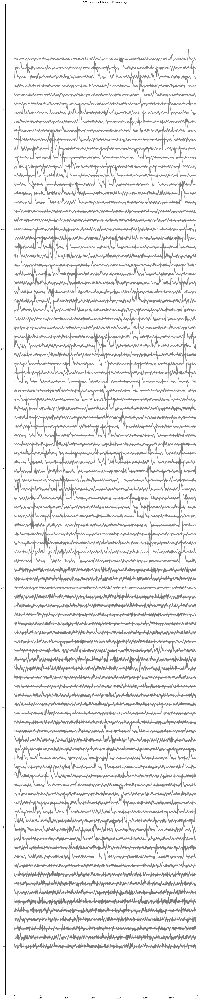

In [365]:
print(dff_dict['dff_gratings_2'].shape)
dff_choirists = dff_dict['dff_gratings_2'][choirists_idx[0]][100:200]
dff_soloists = dff_dict['dff_gratings_2'][soloists_idx[0]][100:200]
offset_choirists = 0.75 * np.arange(dff_soloists.shape[0]).reshape(-1, 1)

print(dff_soloists.shape)
plt.figure(figsize=(20, 100))
for idx,i in enumerate(dff_soloists):
    plt.plot((i+offset_choirists[idx]), color="tab:gray")
    plt.title(f"DFF traces of soloists for drifting gratings")

(2708, 1742)
(2708, 1735)
(2708, 2725)
(2708, 3267)
(2708, 1820)


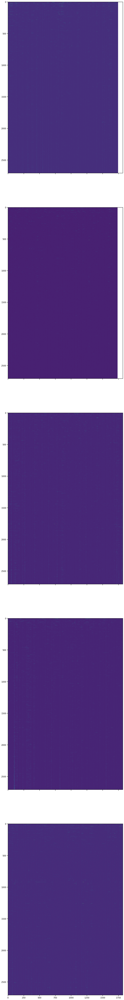

In [139]:
# Code to plot the dff traces based on population coupling 
sorting_order=[]
sorted_dff = {key:[] for key in cell_coupling} # a dictionary of all sorted dff traces
fig, axs = plt.subplots(nrows= 5, ncols = 1, figsize = (100,100), sharex = True, sharey = True)
axs = axs.flatten()
for idx, (key,p_coupling) in enumerate(cell_coupling.items()):
    sorting_order.append(np.argsort(p_coupling.flatten()))
    dff_key = list(dff_dict.keys())[idx]
    sorted_dff[key]=np.array(dff_dict[dff_key][sorting_order[idx]])
    print(sorted_dff[key].shape)
    axs[idx].imshow(sorted_dff[key])


dict_items([('p_coupling_drifting_gratings_full', [array([[-0.05913846,  0.1870169 ,  0.43534621, ..., -0.05314479,
        -0.08269208,  0.05885001],
       [-0.01439346,  0.08381836,  0.13541811, ...,  0.11107975,
         0.05048017,  0.05770247],
       [ 0.09381828,  0.05983694,  0.11670579, ...,  0.01347498,
        -0.00348419, -0.03949696],
       ...,
       [ 0.10987877,  0.25007321,  0.19104966, ..., -0.03786055,
        -0.11765252,  0.05638903],
       [-0.00095493,  0.0607004 ,  0.05805818, ...,  0.11763581,
         0.02468544, -0.01118405],
       [ 0.02449466,  0.15198317,  0.23031894, ...,  0.10133138,
        -0.00677424,  0.07173132]])]), ('p_coupling_natural_movies', [array([[ 0.49212752,  0.49058868,  0.66596444, ..., -0.04076952,
        -0.00291719,  0.04689293],
       [ 0.07425867,  0.11287022,  0.05276664, ...,  0.06586034,
        -0.03864697, -0.05294244],
       [ 0.09474794,  0.03424347,  0.00343535, ...,  0.04888205,
         0.10433657, -0.04072066],
  

### Bin by drifting gratings presentation

In [132]:
stimulus_table = nwb.intervals['stimulus_table'].to_dataframe()

selected_stimulus_table = stimulus_table[
    (stimulus_table['stim_name'] == 'drifting_gratings_full')
    & (stimulus_table['start_time'] <= 341.941071)  # Stop time of 1st epoch
]
selected_stimulus_table

,stim_name,start_time,stop_time,temporal_frequency,spatial_frequency,direction,frame,image_order,image_index,stimulus_condition_id
id,,,,,,,,,,
0,drifting_gratings_full,54.718670,56.703613,1.0,0.04,210.0,NaN,NaN,NaN,7
1,drifting_gratings_full,57.721142,59.706112,1.0,0.08,210.0,NaN,NaN,NaN,19
2,drifting_gratings_full,60.723713,62.708641,1.0,0.04,60.0,NaN,NaN,NaN,2
3,drifting_gratings_full,63.726173,65.711128,1.0,0.04,180.0,NaN,NaN,NaN,6
4,drifting_gratings_full,66.728699,68.713623,1.0,0.08,30.0,NaN,NaN,NaN,13
...,...,...,...,...,...,...,...,...,...,...
91,drifting_gratings_full,327.946075,329.931091,1.0,0.08,270.0,NaN,NaN,NaN,21
92,drifting_gratings_full,330.948578,332.933594,1.0,0.04,30.0,NaN,NaN,NaN,1
93,drifting_gratings_full,333.951080,335.936096,1.0,0.04,240.0,NaN,NaN,NaN,8


In [133]:
timestamps = normd_sel_session_data['timestamps']
dff_traces = normd_sel_session_data['dff_traces']
behavior_traces = normd_sel_session_data['behavior_traces']

# Now, let's bin them!
n_timebins = len(selected_stimulus_table)
binned_normd_sel_session_data = deepcopy(normd_sel_session_data)
binned_normd_sel_session_data['timestamps'] = selected_stimulus_table.start_time.values
binned_normd_sel_session_data['dff_traces'] = np.zeros((len(dff_traces), n_timebins))
binned_normd_sel_session_data['behavior_traces'] = np.zeros((len(behavior_traces), n_timebins))
for i, row in selected_stimulus_table.iterrows():
    start_time = row['start_time']
    stop_time = row['stop_time']

    mask = (timestamps >= start_time) & (timestamps <= stop_time)
    if len(mask) > 0:
        binned_normd_sel_session_data['dff_traces'][:,i] = np.mean(dff_traces[:,mask], axis=-1)
        binned_normd_sel_session_data['behavior_traces'][:,i] = np.mean(behavior_traces[:,mask], axis=-1)
    else:
        print(start_time, stop_time, 'empty mask')

for k, v in binned_normd_sel_session_data.items():
    print(f"{k}: {v.shape}")

timestamps: (96,)
dff_traces: (2066, 96)
plane_ids: (2066,)
roi_ids: (2066,)
behavior_traces: (2, 96)
behavior_names: (2,)


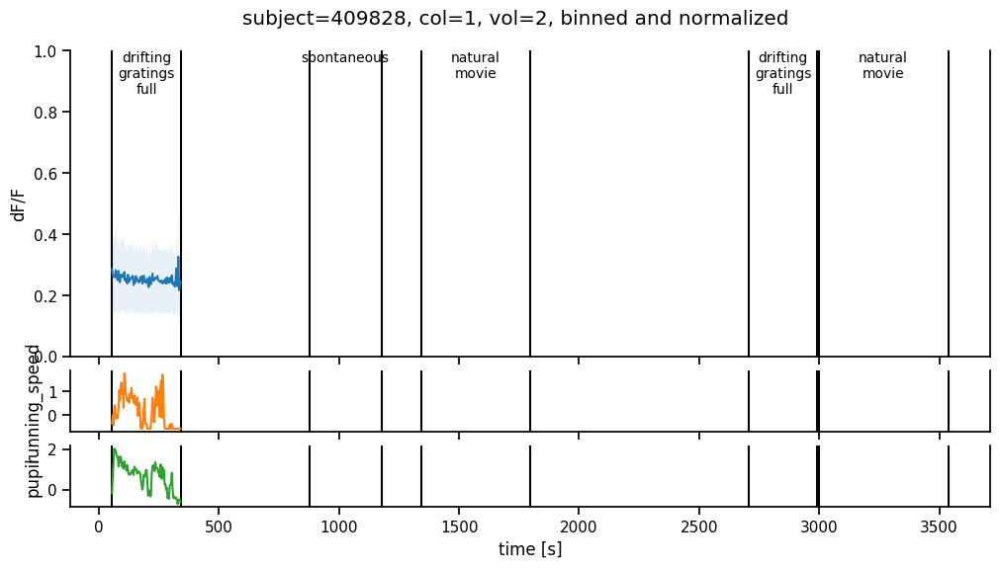

In [134]:
timestamps = binned_normd_sel_session_data['timestamps']
dff_avg = np.nanmean(binned_normd_sel_session_data['dff_traces'], axis=0)
dff_std = np.nanstd(binned_normd_sel_session_data['dff_traces'], axis=0)
behavior_traces = binned_normd_sel_session_data['behavior_traces']
behavior_names = binned_normd_sel_session_data['behavior_names']

# ========================================================================
fig, axs = plt.subplots(
    nrows=3, height_ratios=[1,0.2,0.2], sharex=True,
    figsize=(12,6)
)
fig.subplots_adjust(hspace=0.1)

# -------------------------------------------------------------------------
# Row 1: Plot avg population trace
# -------------------------------------------------------------------------
ax = axs[0]
ax.plot(timestamps, dff_avg, c='C0', label='df/F')
ax.fill_between(
    timestamps, dff_avg-dff_std, dff_avg+dff_std,
    color='C0', ec='none', alpha=0.1, zorder=1
)

ax.set_ylim(0,1)
ax.set_ylabel("dF/F")

# Add standard scaled behaviors
for i, (ax, name) in enumerate(zip(axs[1:], behavior_names)):
    ax.plot(timestamps, behavior_traces[i], color=f'C{i+1}')
    ax.set_ylabel(name)
    
    # ymin = np.percentile(behavior_traces[i], 2)
    # ymax = np.percentile(behavior_traces[i], 99)
    # ymin, ymax = -1.25, 5
    # ax.set_ylim(ymin,ymax)

# Plot stimulus epochs
for _, row in stim_epochs_df.iterrows():
    stim_name = row['stim_name']
    start_time = row['start_time']
    stop_time = row['stop_time']

    for ax in axs:
        ax.axvline(start_time, color='k', zorder=0)
        ax.axvline(stop_time, color='k', zorder=0)

        # Annotate
        if ax.get_subplotspec().is_first_row():
            xtext = 0.5*(stop_time-start_time) + start_time  # data coordinates
            ax.text(
                xtext, 1, '\n'.join(stim_name.split('_')), transform=ax.get_xaxis_transform(),
                ha='center', va='top', fontsize='small'
            )

# make pretty
ax.set_xlabel("time [s]")
ax.margins(x=0.0)

fig.suptitle(
    f'subject={selected_session.subject_id.item()}, '
    + f'col={selected_session.column.item()}, '
    + f'vol={selected_session.volume.item()}'
    + ', binned and normalized',
    y=0.95
)

sns.despine(right=False)

### Individual responses

Finally, let's take a look at the individual responses of each neuron in the normalized and binned case.

Text(0.5, 0.95, 'drifting_gratings_full, single neuron response, binned and normalized')

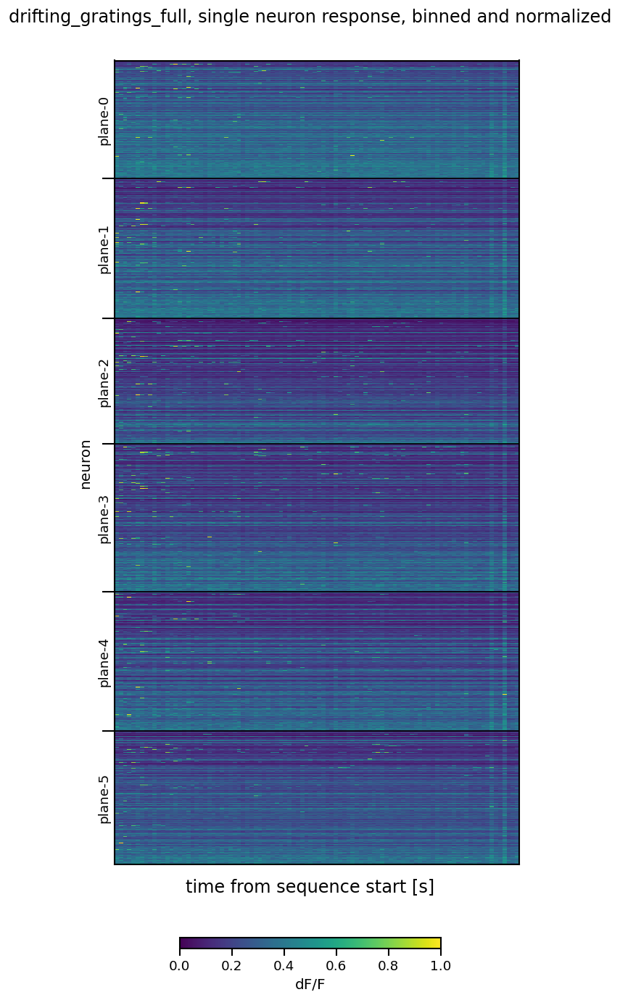

In [135]:
dff = binned_normd_sel_session_data['dff_traces']

# Set up drawing horizontal lines at every plane
plane_ids = binned_normd_sel_session_data['plane_ids']
y_cluster_edges = np.nonzero(plane_ids[1:] - plane_ids[:-1])[0] + 1

y_cluster_centers = np.concatenate([
    [0.5*y_cluster_edges[0]],  # first cluster
    0.5*(y_cluster_edges[1:] - y_cluster_edges[:-1]) + y_cluster_edges[:-1],
    [0.5*(len(plane_ids) - y_cluster_edges[-1]) + y_cluster_edges[-1]]  # last cluster
])

y_cluster_labels = [f'plane-{plane_id}' for plane_id in np.unique(plane_ids)]

# Set color norm
norm = mpl.colors.Normalize(vmin=0, vmax=1,)

fig, ax = plt.subplots(figsize=(6,12), dpi=120)
# for ax, start_index, stop_index in zip(axs, start_indices, stop_indices):
im = ax.imshow(dff, norm=norm, interpolation='none', aspect='auto')

for edge in y_cluster_edges:
    ax.axhline(edge, color='k', lw=1)

# Annotate y-axis with plane
ax.set_yticks(y_cluster_edges)
ax.tick_params(axis='y', labelleft=False, length=10)

ax.set_yticks(y_cluster_centers, minor=True)
ax.set_yticklabels(y_cluster_labels, minor=True, rotation=90, va='center',)
ax.tick_params(axis='y', which='minor', left=False, length=0)

# Hide x-axis ticks
ax.tick_params(labelbottom=False, bottom=False)

if ax.get_subplotspec().is_first_col():
    ax.set_ylabel('neuron')

fig.supxlabel("time from sequence start [s]", y=0.10)

# Add color bar
fig.subplots_adjust(top=0.9, bottom=0.13)
cax = fig.add_axes((0.25,0.05, 0.5, 0.01))   # (l,b,w,h)
fig.colorbar(im, cax=cax, label='dF/F', orientation='horizontal')

# Add title
fig.suptitle("drifting_gratings_full, single neuron response, binned and normalized", y=0.95)